# Saving the world cycling
### Final project in 02806 Social data analysis and visualization, May 2022

By: Andreas Piper Mårtensson (s174489), Maja Jønck Hjuler (s164590) and Tomasz Mariusz Koziak (s210215)


Welcome to our explainer notebook for the website: [Saving the world cycling](https://andreaspiper.github.io/)!

The notebook is divided in the following sections:
1. Motivation
2. Basic stats
3. Data analysis
4. Genre
5. Visualizations
6. Discussion
7. Contributions
8. References

## 1) Motivation

In the battle against climate change, we need to find ways of minimizing greenhouse gas emissions. The transport sector is contributing immensely to the total emissions, hence finding clean ways of transportation is key. Denmark is one of the most biking countries in the world - its a means of transport with no CO2 emission connected to it! Plus it has lots of health benefits for the rider! This already covers two of the UN sustanability goals: Climate action and Good health and well-being. Denmark is known for its' bike culture and the bike infrastructure of Danish cities is copied across the world and this relates to a third UN goal: Sustainable cities and communities. Therefore, we have decided to focus our project on **Danish bicycle habits**. <br/>
We aim to answer questions such as:
- Who bikes?
- Which municipalities bike the most, the longest and the fastest?
- Can we predict biking habits from demographic data?
- Has there been an increase in the use of electrical bikes and bikes in general?

Our goal for the end user's experience is that they will gain a deep understanding of Danish bicycle habits and also get insights into how cycling can contribute in the fight against climate change. Many of our plots are interactive to give the end user a personalized experience and allow for exploration beyound the conclusions that we have reached.

### About the data source

The data used in this project comes from the Danish National Travel Survey ([Transportvaneundersøgelsen](https://www.cta.man.dtu.dk/transportvaneundersoegelsen/dokumentation)), which is a survey that aims to gather information on the transport behaviour of Danes residing in Denmark. The survey is managed by DTU Transport on behalf of a group of Danish authorities and organisations. Here are some key points that describe the survey:

* It contains a one-day travel diary combined with various background questions
* Every day contains several trips with different modes of transport
* Covers 365 days a year
* Regards Danish residents, 10-84 years of age
* Interviews are performed from 2006-2021

We have chosen this dataset since it contains detailed information on Danish bicycle habits, demographic/social data as well as geospacial data. This gives lots of opportunities for exploration and good foundations for answering the questions listed above.


## 2) Basic stats

We will use two main datasets from the TU database. The **Session dataset** contains the background data about the person being interviewed, such as age, gender, home address, occupation etc. It contains:

**196006** one-day travel diaries in total

**139093** (71%) of participants owns a bike 🚲

The **Tur** dataset contains information on every trip in the one-day travel diary and includes details such as the time of departure and arrival, the mode of transport and the purpose of the trip. This dataset contains:

**575629** trips in total

**88688** (15%) bike trips 🚲

In our analysis, we will use subsets of the dataset depending on the analysis aim. In general, we focus on the trips where 'bicycle' is the primary mode of transport. Furthermore, for parts of the analysis we focus on the 15 top municipalities when it comes to total distance travelled by bike.

In [6]:
import pandas as pd
import numpy as np
import requests
import matplotlib.pyplot as plt 
import json
from scipy.interpolate import splev, splrep
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import plot_tree
import geopandas as gpd # Install by using this command: "conda install -c conda-forge geopandas"
import plotly.express as px
import folium
from folium import plugins
from folium.plugins import HeatMap

In [7]:
pd.set_option('display.float_format', lambda x: '%.4f' % x)

In [8]:
size = 14
params = {'legend.fontsize': 'large',
          'figure.figsize': (6.4, 4.8),
          'axes.labelsize': size,
          'axes.titlesize': size,
          'xtick.labelsize': size*0.75,
          'ytick.labelsize': size*0.75,
          'axes.titlepad': 25,
          'figure.dpi': 100
         }
plt.rcParams.update(params)

### Import and preprocess data

The preprocessing includes reading the original dataset into pandas dataframes and selecting the columns that will be usefull for our analysis. Furthermore, we create new columns for date, year, month and weekday to use for a temporal analysis later on. The preprocessing steps are included below but are commented out to save time when running the notebook. Instead, we read in the preprocessed dataframes directly. 

In [9]:
import datetime
def serial_date_to_string(srl_no):
    new_date = datetime.datetime(1970,1,1,0,0) + datetime.timedelta(srl_no)
    return new_date.strftime("%Y-%m-%d")

```# Session dataset: Contains interviews about trips on a given date with a given respondent```

```df_session = pd.read_csv('session.csv', delimiter = ';', on_bad_lines='skip', low_memory = False)```

```session_columns = df_session[['SessionId', 'DiaryDate', 'DiaryYear', 'DiaryMonth', 'DiaryWeekday', 'HomeAdrMunCode', 
    'HomeAdrCityCode', 'HomeAdrNearestStation', 'HomeAdrDistNearestStation', 'RespSex', 'RespAgeCorrect', 'RespPrimOcc', 
    'RespEdulevel', 'RespHasBicycle', 'IncRespondent2000', 'DayStartMuncode', 'DayStartCityCode', 'DayStartPurp', 
    'TotalBicLen', 'PrimModeDay', 'ModeChainTypeDay', 'JstartMuncode', 'DayPrimTargetPurp']]```

```session_columns['Date'] = session_columns['DiaryDate'].apply(serial_date_to_string)```<br/>
```session_columns['Year'] = pd.to_datetime(session_columns['Date']).dt.year```<br/>
```session_columns['Month'] = pd.to_datetime(session_columns['Date']).dt.month```<br/>
```session_columns['Weekday'] = pd.to_datetime(session_columns['Date']).dt.weekday```<br/>

```session_columns.to_csv(r'session_proc.csv', index=False)```

In [10]:
# Shortcut to read in processsed dataframe
session_columns = pd.read_csv('session_proc.csv')

```# The trip from one stay/purpose to the next```<br/>
```df_tur = pd.read_csv('tur.csv', delimiter = ';', on_bad_lines='skip', low_memory = False)```

```tur_columns = df_tur[['TurId', 'SessionId', 'DepartHH', 'DepartMM', 'ArrivalHH', 'ArrivalMM', 'OrigMuncode', 'OrigCityCode', 
    'DestMuncode', 'DestCityCode', 'TripPurpGroup', 'SumLen', 'SumMin', 'PrimMode', 'PrimModeSumlen', 'BicType', 
    'JourneyRole']]```<br/>
    
```# Create column with bike speed```<br/>
```tur_columns['Speed'] = tur_columns['SumLen'] / (tur_columns['SumMin'] / 60)```

```# convert float to int```<br/>
```tur_columns.iloc[:,0:11] = tur_columns.iloc[:,0:11].fillna(0)```<br/>
```tur_columns.iloc[:,13:17] = tur_columns.iloc[:,13:17].fillna(0)```<br/>
```tur_columns.iloc[:,0:11] = tur_columns.iloc[:,0:11].astype(int)```<br/>
```tur_columns.iloc[:,13:17] = tur_columns.iloc[:,13:17].astype(int)```

```tur_columns.to_csv(r'tur_proc.csv', index=False)```

In [11]:
# Shortcut to read in processsed dataframe
tur_columns = pd.read_csv('tur_proc.csv')

In [12]:
# Define dictionary with municipality codes and municipalities names
city_codes = pd.read_csv('csv_en.csv', delimiter = ';').iloc[:,0:4]
city_code_dict = dict(zip(city_codes.CODE, city_codes.TITLE))

# For example, Copenhagen has code 101
city_code_dict[101]

'København'

### Getting to know the Session dataset

The Session dataset contains the background data about the person being interviewed, such as age, gender, home address, occupation etc.

In [13]:
TotInt = len(session_columns)
TotIntHasBike = len(session_columns[session_columns['RespHasBicycle'] == 1])
TotIntBike = len(session_columns[session_columns['PrimModeDay'] == 2])
TotIntDidBike = len(session_columns[session_columns['TotalBicLen'] > 0])
print('Number of participants/interviews:', TotInt)
print('Number of participants who has a bike:', TotIntHasBike)
print('Bike owner percentage:', round(TotIntHasBike/TotInt,3)*100, '%')
print('-----')
print('Number of participant who used bike as primary mode of transport for the entire day:',TotIntBike)
print('Cyclist percentage:', round(TotIntBike/TotInt*100,1), '%')
print('-----')
print('Number of participant who used bike during the day:',TotIntDidBike)
print('Did bike percentage:', round(TotIntDidBike/TotInt*100,1), '%')

Number of participants/interviews: 196006
Number of participants who has a bike: 139093
Bike owner percentage: 71.0 %
-----
Number of participant who used bike as primary mode of transport for the entire day: 23360
Cyclist percentage: 11.9 %
-----
Number of participant who used bike during the day: 36856
Did bike percentage: 18.8 %


The bar chart below shows the number of interviews conducted per year since the beginning of the survey in 2006.

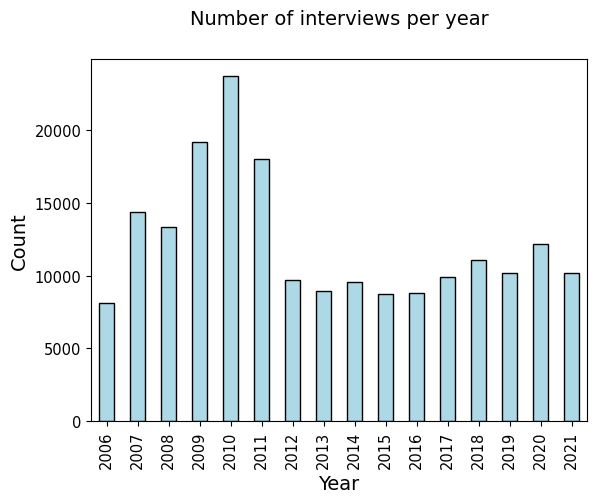

In [14]:
session_columns.groupby(['Year'])['SessionId'].count().plot(kind = 'bar', title = 'Number of interviews per year', ylabel = 'Count', facecolor = "lightblue", edgecolor = "black");

The fraction of interviews containing bike trips has stayed roughly constant throughout the years.

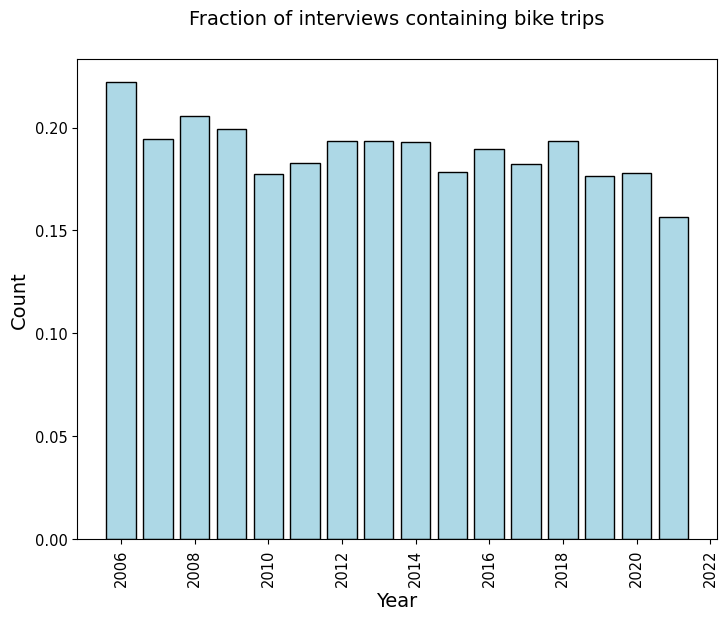

In [15]:
session_bike = session_columns[session_columns['TotalBicLen'] > 0]
x = session_bike.groupby(['Year'])['SessionId'].count().values / session_columns.groupby(["Year"])["SessionId"].count().values
y = session_columns.groupby(['Year'])['SessionId'].count().keys()

fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(y, x, facecolor = "lightblue", edgecolor = "black")
plt.xticks(rotation='vertical')
plt.ylabel('Count')
plt.xlabel('Year')
plt.title('Fraction of interviews containing bike trips')
plt.show()

### Focusing on the cyclists in the dataset

Next, we filter out the bike trips in the dataset.

In [16]:
session_bike = session_columns[session_columns['TotalBicLen'] > 0]

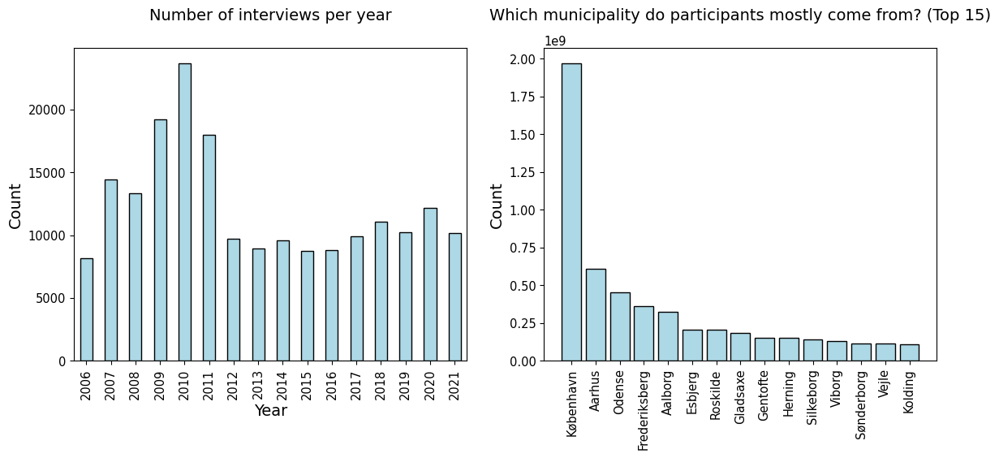

In [17]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (12, 6))
session_columns.groupby(['Year'])['SessionId'].count().plot(kind = 'bar', title = 'Number of interviews per year', ylabel = 'Count', facecolor = "lightblue", edgecolor = "black", ax = ax1)

HomeAdrMunVal = session_bike.groupby(['HomeAdrMunCode'])['SessionId'].sum().sort_values(ascending = False).values[:15]
HomeAdrMunKeys = session_bike.groupby(['HomeAdrMunCode'])['SessionId'].sum().sort_values(ascending = False).keys()[:15]

ylabels = []
for code in HomeAdrMunKeys.to_list():
    ylabels.append(city_code_dict[code])
    
ax2.bar(ylabels,HomeAdrMunVal, facecolor = "lightblue", edgecolor = "black")
plt.xticks(rotation='vertical')
plt.ylabel('Count')
plt.title('Which municipality do participants mostly come from? (Top 15)')
plt.tight_layout(pad = 2.0)

### Demographic analysis

This section explores the gender distribution of Danish cyclists as well as their occupation and educational level.

In [18]:
bike_age_df = session_bike.copy()
bike_age_df['RespAgeCorrect'] = pd.cut(bike_age_df.RespAgeCorrect,range(0,90,5), right=True)

In [19]:
bike_age_df = bike_age_df.groupby(['RespAgeCorrect','RespSex'])['RespSex'].count().unstack().reset_index()

In [20]:
bike_age_df.rename(columns = {'RespAgeCorrect': 'Age', 1: 'Male', 2: 'Female'}, inplace = True)

In [21]:
bike_age_df['Male'] = bike_age_df['Male'] / -1
bike_age_df['Female'] = bike_age_df['Female'] / 1

In [22]:
ages = bike_age_df.Age.values.tolist()[::-1]

Only looking at the 15 mostly biking municipalities in Denmark there is a close to equal distribution between male and female cyclists. There are 19700 female and 17156 male, hence the women/girls are overrepresented by 15% compared to the men/boys. The population pyramid below illustrates the age distribution for both genders. Surprisingly, the ten to fifteen year olds either constitute a big part of the trip dataset or they bike relatively more often than the other age groups.

Population pyramid is inspired by [source](https://maciejtarsa.medium.com/plotting-a-population-pyramid-in-python-52be034968b0).

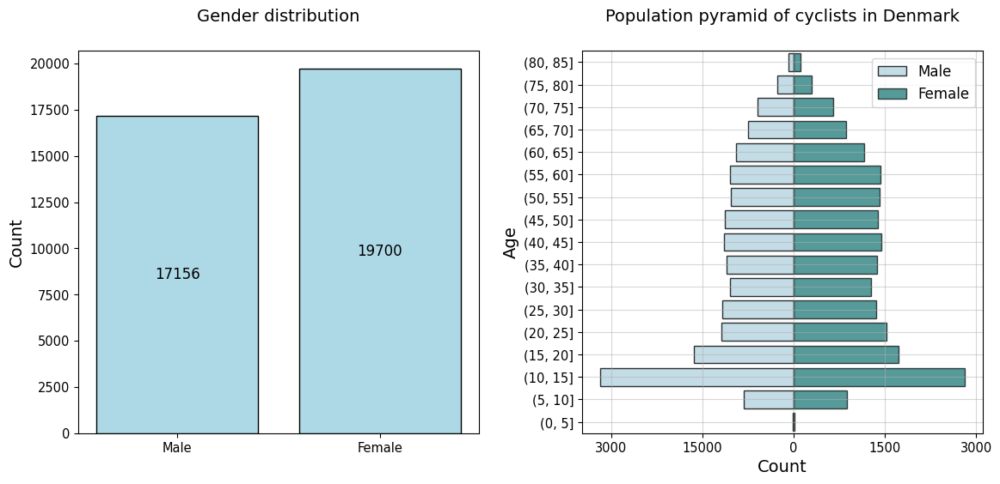

In [23]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (12, 6))
p = ax1.bar(['Male', 'Female'], session_bike.groupby(['RespSex'])['SessionId'].count().values, facecolor = "lightblue", edgecolor = "black")
ax1.set_title("Gender distribution")
ax1.bar_label(p, label_type='center', fontsize = 12)
ax2.set_xlabel(['Male', 'Female'])
ax1.set_ylabel('Count');

sns.barplot(x='Male', y='Age', data=bike_age_df, order=ages, color = "lightblue", edgecolor = "k", alpha = 0.8, label = 'Male', ax = ax2)
sns.barplot(x='Female', y='Age', data=bike_age_df, order=ages, color = "teal", edgecolor = "k", alpha = 0.7, label = 'Female', ax = ax2)
plt.title("Population pyramid of cyclists in Denmark")
plt.xlabel("Count")
plt.grid(alpha = 0.5)
plt.legend()
plt.xticks(ticks=[-3000, -1500, 0, 1500, 3000], labels=['3000', '15000', '0', '1500', '3000']);
plt.tight_layout(pad = 2.0)


In [24]:
print('Total number of Males:', session_bike.groupby(['RespSex'])['SessionId'].count().values[0])
print('Total number of Females:', session_bike.groupby(['RespSex'])['SessionId'].count().values[1])

Total number of Males: 17156
Total number of Females: 19700


The dataset also contains information about the occupation of respondents. The great majority are employed, while many are pupils at primary school (grade 1-10). University students and retirees are also well-represented.

In [25]:
occ_dict = {103: 'Kindergarten, pre-school', 107: 'Pupil (primary school etc.)', 116: 'Pupil (high school etc.)', 120: 'Student at university or other further education', 130: 'Apprentice, trainee', 210: 'Employee', 211: 'National serviceman', 221: 'Self-employed', 222: 'Assisting spouse (to self-employed person)', 231: 'Leave w/salary', 232: 'Leave on state benefits', 233: 'Leave w/o pay', 310: 'Unemployed, unemployment benefit', 320: 'Social assistance, rehabilitation, long-term ill', 350: 'Non-age pensioner (e.g disabled)', 360: 'Receiver of pre-retirement pay', 370: 'Old Age pensioner', 390: 'Full-time housewife, otherwise out of work'}

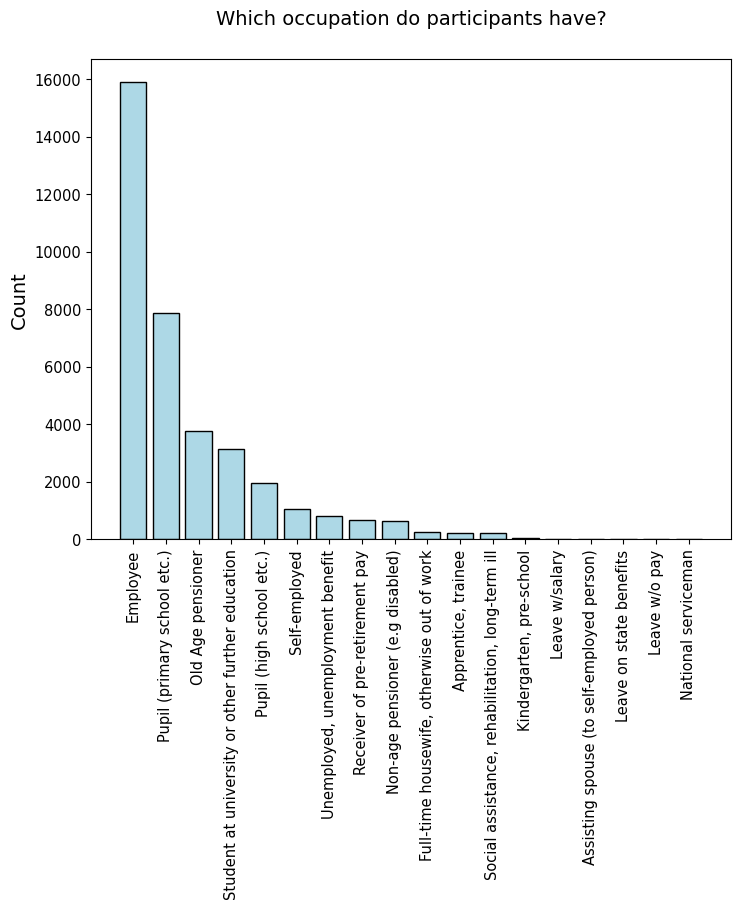

In [26]:
y = session_bike.groupby(['RespPrimOcc'])['SessionId'].count().sort_values(ascending= False).values
x = session_bike.groupby(['RespPrimOcc'])['SessionId'].count().sort_values(ascending= False).keys()

ylabels = []
for code in x.to_list():
    ylabels.append(occ_dict[code])
    
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(ylabels,y, facecolor = "lightblue", edgecolor = "black")
plt.xticks(rotation = 90)
plt.ylabel('Count')
plt.title('Which occupation do participants have?')
plt.show()

Below is a bar chart for the education level of respondents. The plot confirms that the majority of people have finished school and are employed. We also see that there is a large number of children in grade 1-7. 

In [27]:
edulevel_dict = {0: '(under 14 years of age)', 1: '1st-7th form', 2: '8th form', 3: '9th form', 4: '10th form', 5: 'Secondary school (STX, HF)', 6: 'HHX, HTX, Business college', 9: 'Other schooling', 11: 'Vocational (apprenticeship, etc.)', 12: 'Short-term further education', 13: 'Medium-term further education', 14: 'Long-term further education'}

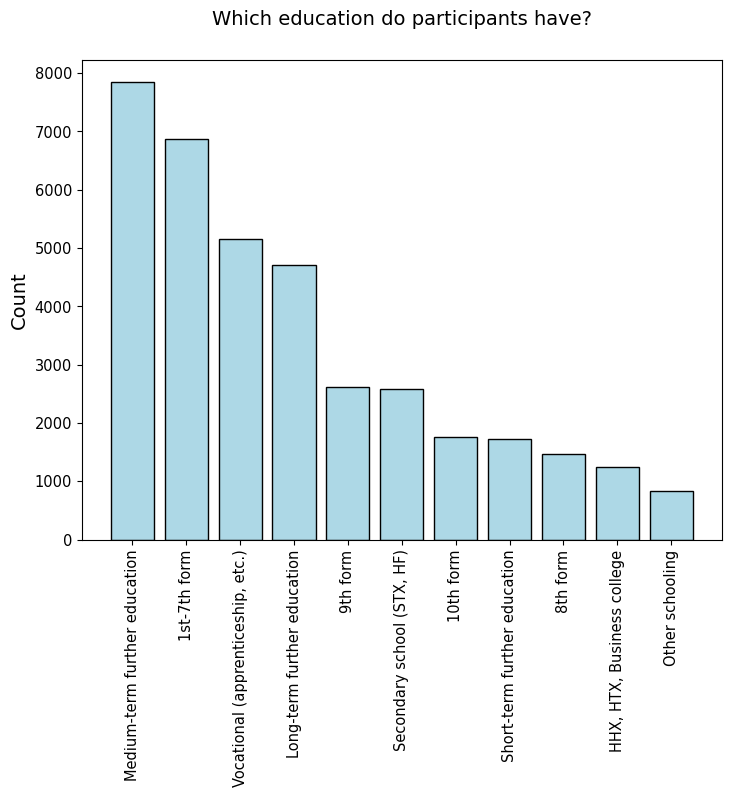

In [28]:
y = session_bike.groupby(['RespEdulevel'])['SessionId'].count().sort_values(ascending= False).values
x = session_bike.groupby(['RespEdulevel'])['SessionId'].count().sort_values(ascending= False).keys()

ylabels = []
for code in x.to_list():
    ylabels.append(edulevel_dict[code])
    
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(ylabels,y, facecolor = "lightblue", edgecolor = "black")
plt.xticks(rotation='vertical')
plt.ylabel('Count')
plt.title('Which education do participants have?')
plt.show()

### Getting to know the Tur dataset

The Tur dataset contains information on every trip in the one-day travel diary and includes details such as the time of departure and arrival, the mode of transport and the purpose of the trip.

In [29]:
tur_columns.head()

,TurId,SessionId,DepartHH,DepartMM,ArrivalHH,ArrivalMM,OrigMuncode,OrigCityCode,DestMuncode,DestCityCode,TripPurpGroup,SumLen,SumMin,PrimMode,PrimModeSumlen,BicType,JourneyRole,Speed
0,47,50026,9,30,10,25,657,11007,779,10791,40,55.0000,55.0000,11,55,0,1,60.0000
1,48,50026,20,30,21,25,779,10791,657,11007,40,55.0000,55.0000,11,55,0,0,60.0000
2,49,50027,9,5,9,10,779,10791,779,10791,40,2.0000,5.0000,11,2,0,21,24.0000
3,50,50027,9,30,9,40,779,10791,779,10791,30,3.5000,10.0000,11,3,0,1,21.0000
4,51,50027,10,15,10,25,779,10791,779,10791,30,2.5000,10.0000,11,2,0,0,15.0000


About 15 percent of the trips in the Tur dataset are by bike.

In [30]:
TotTrips = len(tur_columns)
TotTripsBike = len(tur_columns[tur_columns['PrimMode'] == 2])
print('Total number of trips in the Tur dataset:', TotTrips)
print('Total number of bike trips:', TotTripsBike)
print('Bike trip percentage:', round(TotTripsBike/TotTrips,3)*100,'%')

Total number of trips in the Tur dataset: 575629
Total number of bike trips: 88688
Bike trip percentage: 15.4 %


In [31]:
bike_tur = tur_columns[tur_columns['PrimMode'] == 2]

Every cyclist in the transport survey has 2.56 bike trips per day on average.

In [32]:
print('Average number of daily bike trips per cyclist:', round(np.mean(bike_tur.groupby(['SessionId'])['TurId'].count()), 2))

Average number of daily bike trips per cyclist: 2.56


The left bar chart below shows the number of interviews conducted per year since the beginning of the survey in 2006. For some reason the number peaked in 2007-2011 but have stayed roughly constant at 10,000 interviews per year since then. The plot to the right shows the summed distance for all bike trips for the top 15 municipalities. Copenhagen bikes more than four times the distance of other cities, however, we have not adjusted for the population difference here.

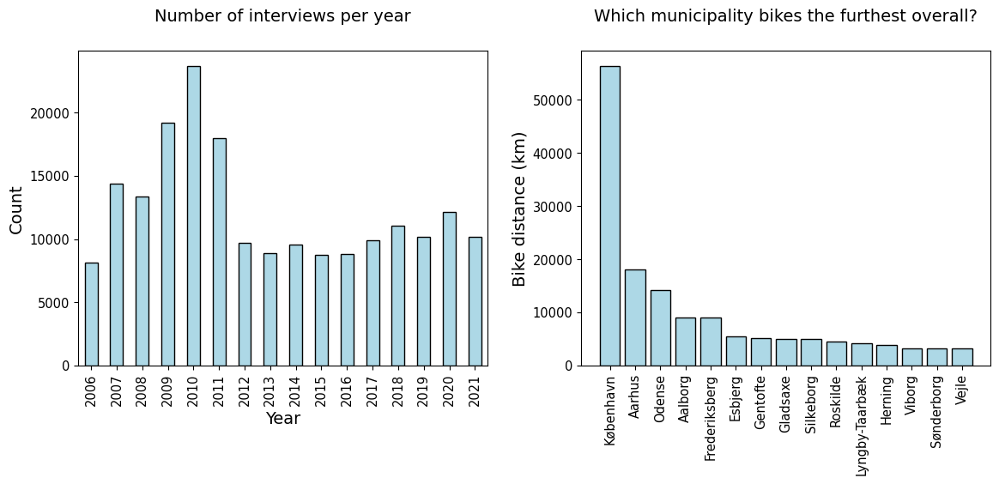

In [33]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (12, 6))
session_columns.groupby(['Year'])['SessionId'].count().plot(kind = 'bar', title = 'Number of interviews per year', ylabel = 'Count', facecolor = "lightblue", edgecolor = "black", ax = ax1)

y = bike_tur.groupby(['OrigMuncode'])['SumLen'].sum().sort_values(ascending = False).values[:15]
x = bike_tur.groupby(['OrigMuncode'])['SumLen'].sum().sort_values(ascending = False).keys()[:15]

ylabels = []
for code in x.to_list():
    ylabels.append(city_code_dict[code])
    
ax2.bar(ylabels, y, facecolor = "lightblue", edgecolor = "black")
ax2.set_ylabel('Bike distance (km)')
plt.xticks(rotation='vertical')
plt.title('Which municipality bikes the furthest overall?')
plt.tight_layout(pad = 2)

# plt.savefig('figures/Number_of_interviews_per_year.png');

## 4) Data analysis

Here’s a few points that describe the average Danish cyclist:
- Live in Copenhagen
- Bike 3.4 km per trip in a time of 15 min
- That equals a speed of 14.3 km/h
- Bike mostly during the late summer/autumn seasons
- Relax during the weekend

### Focustrips

In our analysis, we will use subsets of the dataset depending on the aim. In general, we focus on the trips where bicycle is the primary mode of transport. Furthermore, we focus on the 15 top municipalities when it comes to total distance travelled. The dataframe ```focustrips``` contains bike trips for these municipalities.

In [34]:
# Municipality codes for 15 most biking municipalities
FocusMunCodes = bike_tur.groupby(['OrigMuncode'])['SumLen'].sum().sort_values(ascending = False).keys()[:15].to_list()
FocusMunCodes

[101, 751, 461, 851, 147, 561, 157, 159, 740, 265, 173, 657, 791, 540, 630]

In [35]:
print('Top 15 biking municipalities:')
print('------------------------------')
for i in range(15):
    print('{}.'.format(i+1), city_code_dict[FocusMunCodes[i]])

Top 15 biking municipalities:
------------------------------
1. København
2. Aarhus
3. Odense
4. Aalborg
5. Frederiksberg
6. Esbjerg
7. Gentofte
8. Gladsaxe
9. Silkeborg
10. Roskilde
11. Lyngby-Taarbæk
12. Herning
13. Viborg
14. Sønderborg
15. Vejle


In [36]:
focustrips = bike_tur[bike_tur['OrigMuncode'].isin(FocusMunCodes)].reset_index(drop = True)
focustrips.head()

,TurId,SessionId,DepartHH,DepartMM,ArrivalHH,ArrivalMM,OrigMuncode,OrigCityCode,DestMuncode,DestCityCode,TripPurpGroup,SumLen,SumMin,PrimMode,PrimModeSumlen,BicType,JourneyRole,Speed
0,137,50053,10,30,10,50,630,0,630,0,40,4.0000,20.0000,2,4,0,1,12.0000
1,138,50053,17,10,17,30,630,0,630,0,40,4.0000,20.0000,2,4,0,0,12.0000
2,178,50084,10,5,10,9,101,1100,101,1100,40,2.0000,4.0000,2,2,0,21,30.0000
3,179,50084,10,30,10,32,101,1100,101,1100,30,0.5000,2.0000,2,0,0,1,15.0000
4,180,50084,11,10,11,12,101,1100,101,1100,30,0.5000,2.0000,2,0,0,22,15.0000


The boxplots below visualize the distribution of bike distance per trip for the 15 municipalities that bike the furthest overall. These are sorted by the average distance such that its easy to see which municipality bikes the furthest per trip (on average). Outliers have been excluded but the mean, the median and interquartile ranges are illustrated in the figure. Citizents in Copenhagen bike around 4 km per trip, but it ranges between a few hundred meters and 10 kilometers. Half of the trips are less than or equal to 2 km as illustrated by the median in the figure below.

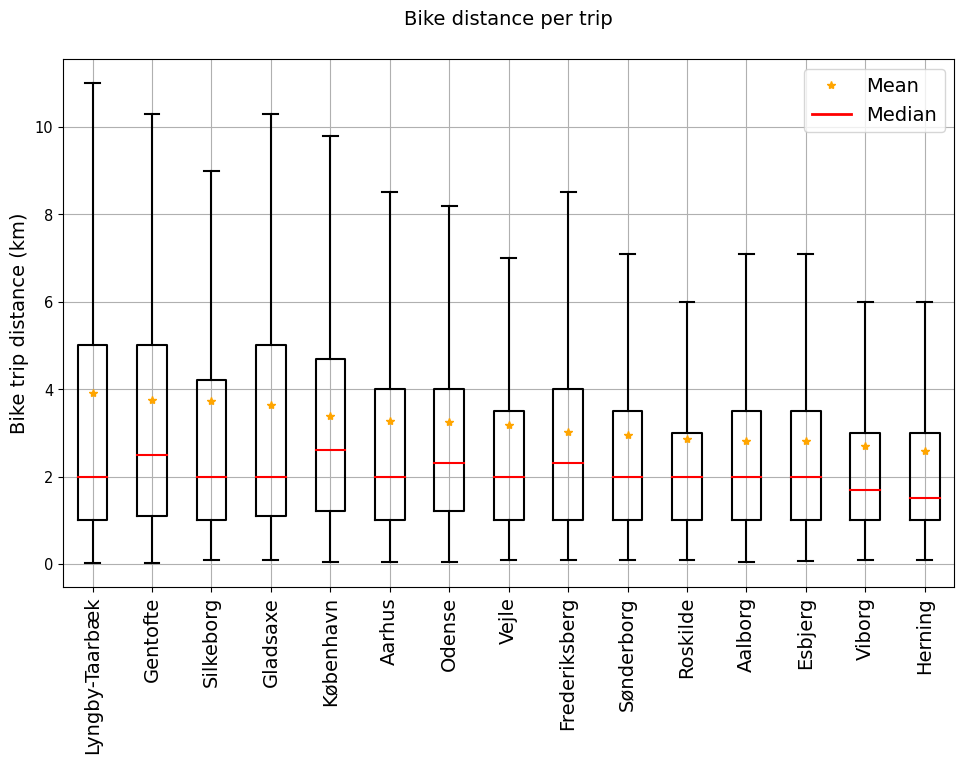

In [37]:
tripLen = focustrips.groupby(['TurId', 'OrigMuncode'])['SumLen'].mean().unstack()
    
muns_order = np.mean(focustrips.groupby(['TurId', 'OrigMuncode'])['SumLen'].mean().unstack(), axis = 0)
muns_order = muns_order.sort_values(ascending = False).keys().tolist()

ylabels2 = []
for code in muns_order:
    ylabels2.append(city_code_dict[code])
    
tripLen[muns_order].boxplot(figsize = (10,8), rot = 90, showmeans = True, showfliers = False, return_type='dict', 
                       boxprops=dict(linestyle='-', linewidth=1.5), 
                       meanprops=dict(markerfacecolor='orange', marker='*', markeredgecolor='orange'),
                       medianprops=dict(linestyle='-', linewidth=1.5, color = 'red'),
                       whiskerprops=dict(linestyle='-', linewidth=1.5),
                       capprops=dict(linestyle='-', linewidth=1.5));
plt.title('Bike distance per trip')
plt.xticks(np.arange(1,16), ylabels2, rotation='vertical', fontsize = 14)
plt.ylabel("Bike trip distance (km)")

plt.plot([], [], '*', linewidth=2, color='orange', label='Mean')
plt.plot([], [], '-', linewidth=2, color='red', label='Median')
plt.legend(loc = 'upper right', fontsize = 14)

plt.tight_layout(pad = 2)
#plt.savefig('figures/Top_15_bike_municipalities.png')

### Temporal analysis of bike trips

The number of bicycle trips changes from day to day and hour to hour. To investigate the trends in biking habits across months, weekdays and hours, the visualization below contains a temporal analysis of the total bike trip count for the 15 municipalities we've seen above. Here are our findings:<br/>
**Months:** One would expect that people bike more during the summer than in the winter since the temperature is higher, and we see that this holds true when comparing the counts in January to those in August. However, it's a general trend that July has a relatively low number of bike trips which might be explained by the fact that most people are away on holiday.<br/>
**Weekdays:** Investigating the Weekday trends, we can confirm that people don't use the bike when they have time off from school and work. The numbers drop significantly during the weekend. This also suggests that the bicycle is used for daily commute and not so much for leisure.<br/>
**Hour:** Analysing the hourly bike counts, there is a peak in the morning from 7-8 am when people are making their way to school or work and again in the afternoon from 3-5 pm when they return home. Interestingly, the peak in the afternoon is broader, hence there is a bigger variation in the time of departure than in the time of arrival.<br/>
**Hour of week:** The plots of the hourly bike trip count may hide some information for daily trends, since these are averaged out over the 24 hours. Therefore, we're plotting the hour of week instead to see the bike tendencies across days with "high resolution", i.e. showing the count per hour. This plot confirms that people bike more often during the weekdays than in the weekend. During the weekdays, people bike in the morning and the afternoon as we concluded before, however, it's opposite in the weekend. Saturday and Sunday people tend to bike during the day instead and we only see a single, broad peak in the bike trip count.



In [38]:
# Shortcut to read in processsed dataframe
focustrips = pd.read_csv('focustrips_proc.csv')

### Continue temporal analysis

In [39]:
focustrips = focustrips[focustrips["Year"]!= 2006]

In [40]:
focustrips.head()

,TurId,SessionId,DepartHH,DepartMM,ArrivalHH,ArrivalMM,OrigMuncode,OrigCityCode,DestMuncode,DestCityCode,...,BicType,JourneyRole,Date,Year,Month,Weekday,Speed,HourOfWeek,Gender,Age
0,28402,59303,10,30,10,33,851,0,851,18336,...,0,1,2007-01-01,2007,1,0,16.0000,11,1,44
1,28403,59303,10,40,10,43,851,18336,851,0,...,0,0,2007-01-01,2007,1,0,16.0000,11,1,44
2,28420,59322,14,0,14,10,740,10667,740,0,...,0,1,2007-01-02,2007,1,1,24.0000,39,2,21
3,28421,59322,15,0,15,10,740,0,740,10667,...,0,0,2007-01-02,2007,1,1,24.0000,40,2,21
4,28439,59331,10,0,10,25,101,1100,157,1100,...,0,0,2007-01-02,2007,1,1,12.0000,35,2,17


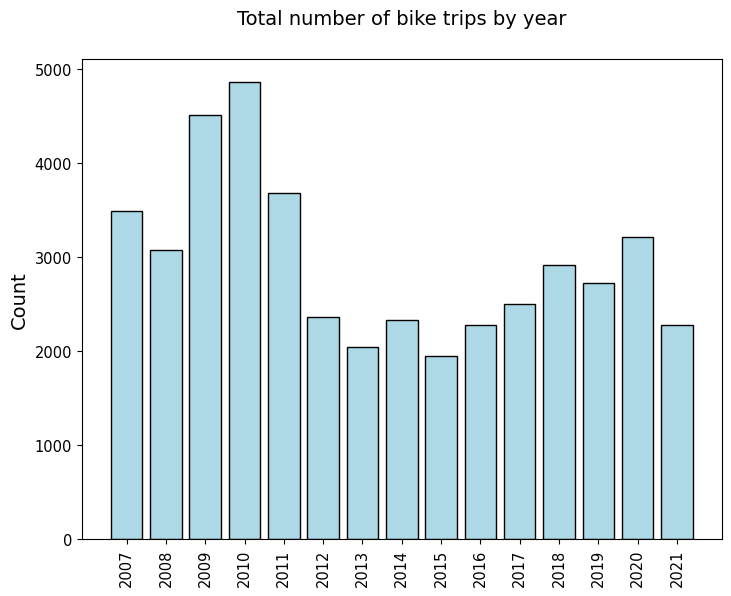

In [41]:
y = focustrips.groupby(["Year"])["TurId"].count().sort_values(ascending = False).values
x = focustrips.groupby(["Year"])["TurId"].count().sort_values(ascending = False).keys()
    
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(x, y, facecolor = "lightblue", edgecolor = "black")
ax.set_ylabel('Count')
ax.set_xticks(x)
plt.xticks(rotation='vertical')
plt.title('Total number of bike trips by year')
plt.show()

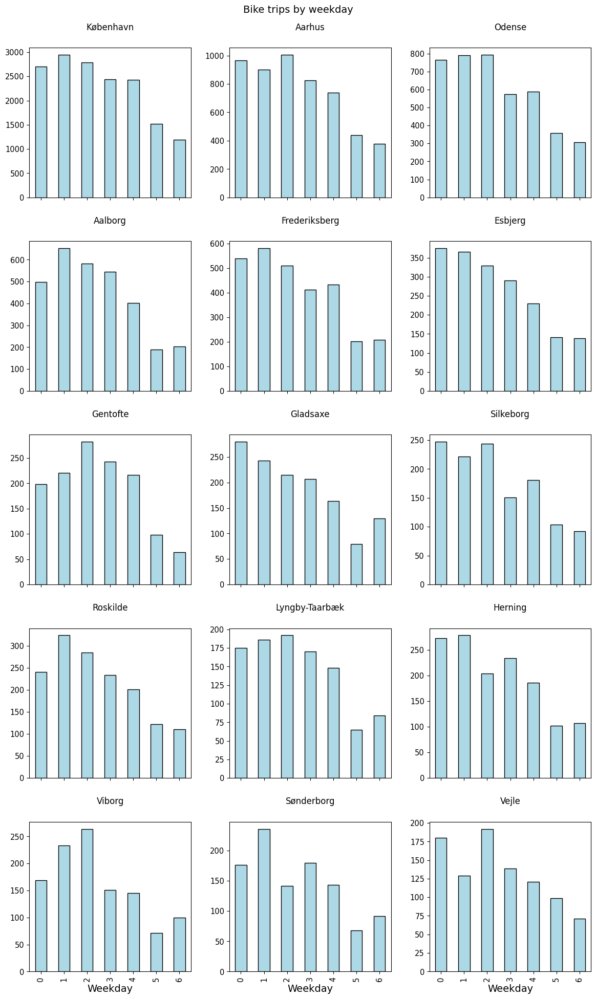

In [42]:
fig, axs = plt.subplots(5,3, figsize = (12, 20), sharex = True)
mun_counts = focustrips.groupby(["OrigMuncode", "Weekday"])["TurId"].count()

x = mun_counts.unstack(level='OrigMuncode').columns
ylabels_temporal = []
for code in x.to_list():
    ylabels_temporal.append(city_code_dict[code])

for i,ax in enumerate(axs.flat):
    ax.set_title(ylabels[i], fontsize = 12)
    mun_counts[FocusMunCodes[i]].plot(kind = 'bar', ax = ax, facecolor = "lightblue", edgecolor = "black")
    
fig.suptitle("Bike trips by weekday", fontsize = 14)
plt.tight_layout(pad=2.0)

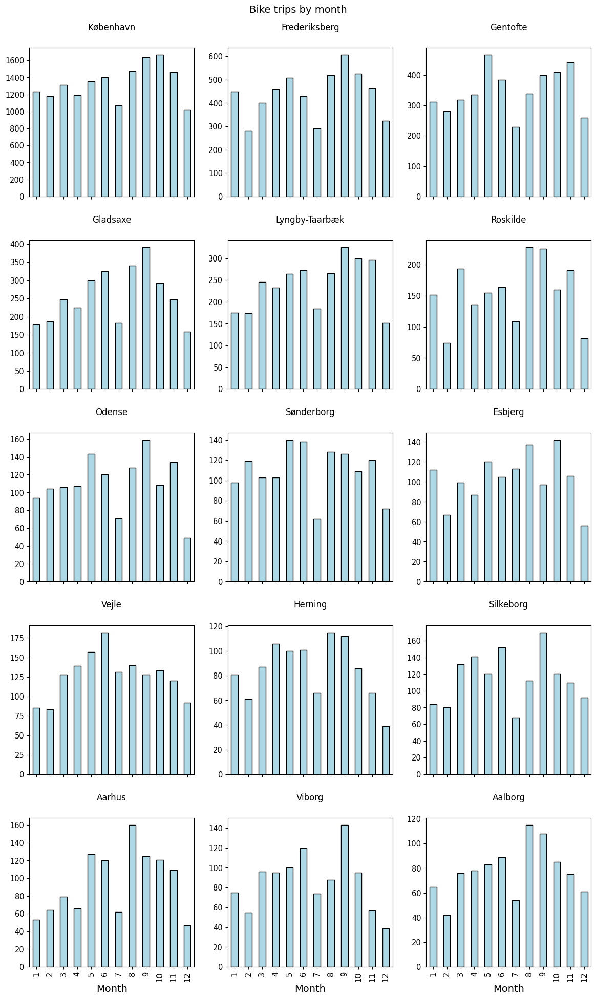

In [43]:
fig, axs = plt.subplots(5,3, figsize = (12, 20), sharex = True)
mun_counts = focustrips.groupby(["OrigMuncode", "Month"])["TurId"].count()

x = mun_counts.unstack(level='OrigMuncode').columns
ylabels_temporal = []
for code in x.to_list():
    ylabels_temporal.append(city_code_dict[code])

for i,ax in enumerate(axs.flat):
    ax.set_title(ylabels_temporal[i], fontsize = 12)
    mun_counts[FocusMunCodes[i]].plot(kind = 'bar', ax = ax, facecolor = "lightblue", edgecolor = "black")
    
fig.suptitle("Bike trips by month", fontsize = 14)
plt.tight_layout(pad=2.0)

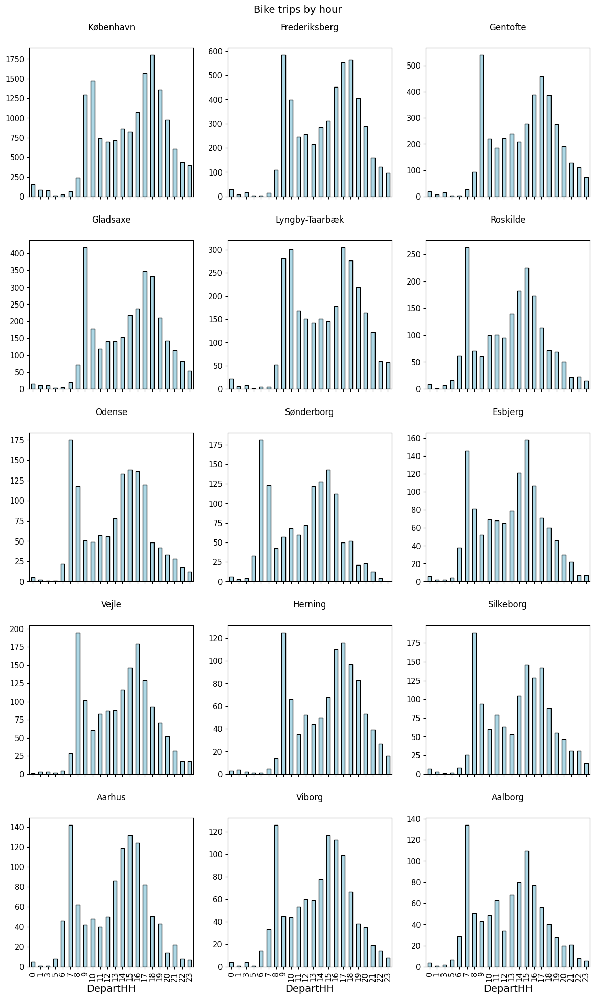

In [44]:
fig, axs = plt.subplots(5,3, figsize = (12, 20), sharex = True)
mun_counts = focustrips.groupby(["OrigMuncode", "DepartHH"])["TurId"].count()

x = mun_counts.unstack(level='OrigMuncode').columns
ylabels_temporal = []
for code in x.to_list():
    ylabels_temporal.append(city_code_dict[code])

for i,ax in enumerate(axs.flat):
    ax.set_title(ylabels_temporal[i], fontsize = 12)
    mun_counts[FocusMunCodes[i]].plot(kind = 'bar', ax = ax, facecolor = "lightblue", edgecolor = "black")
    
fig.suptitle("Bike trips by hour", fontsize = 14)
plt.tight_layout(pad=2.0)

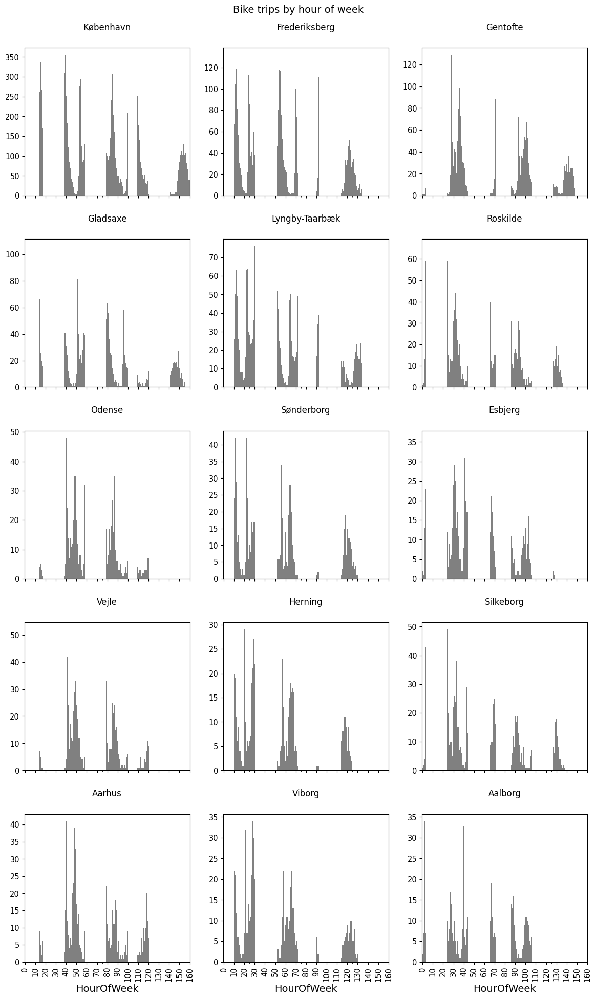

In [45]:
fig, axs = plt.subplots(5,3, figsize = (12, 20), sharex = True)
mun_counts = focustrips.groupby(["OrigMuncode", "HourOfWeek"])["TurId"].count()

x = mun_counts.unstack(level='OrigMuncode').columns
ylabels_temporal = []
for code in x.to_list():
    ylabels_temporal.append(city_code_dict[code])

for i,ax in enumerate(axs.flat):
    ax.set_title(ylabels_temporal[i], fontsize = 12)
    mun_counts[FocusMunCodes[i]].plot(kind = 'bar', ax = ax, xticks = np.arange(0,170,10), color = 'grey')
    
fig.suptitle("Bike trips by hour of week", fontsize = 14)
plt.tight_layout(pad=2.0)

### Development in the use of electric bikes

What type of bicycle was used on the trip ? **Questions asked after May 2014**

NB: only looking at ```focustrips``` !

In [46]:
focustripsAfter2013 = focustrips[focustrips['Year'] > 2013]

In [47]:
bictype_dict = {0: 'Data missing', 20: 'Ordinary two wheel bike', 21: 'Tandem', 22: 'Bike with trailer', 23: 'Electric bicycle', 24: 'Speed Pedelec (45 km/h)', 30: 'Carrier cycle, Christianiabicycle', 33: 'Electric Carrier cycle', 40: 'Recumbent bicycle or other special bicycle', 99: 'Different bikes on the individual parts of the trip'}
bictype_dict

{0: 'Data missing',
 20: 'Ordinary two wheel bike',
 21: 'Tandem',
 22: 'Bike with trailer',
 23: 'Electric bicycle',
 24: 'Speed Pedelec (45 km/h)',
 30: 'Carrier cycle, Christianiabicycle',
 33: 'Electric Carrier cycle',
 40: 'Recumbent bicycle or other special bicycle',
 99: 'Different bikes on the individual parts of the trip'}

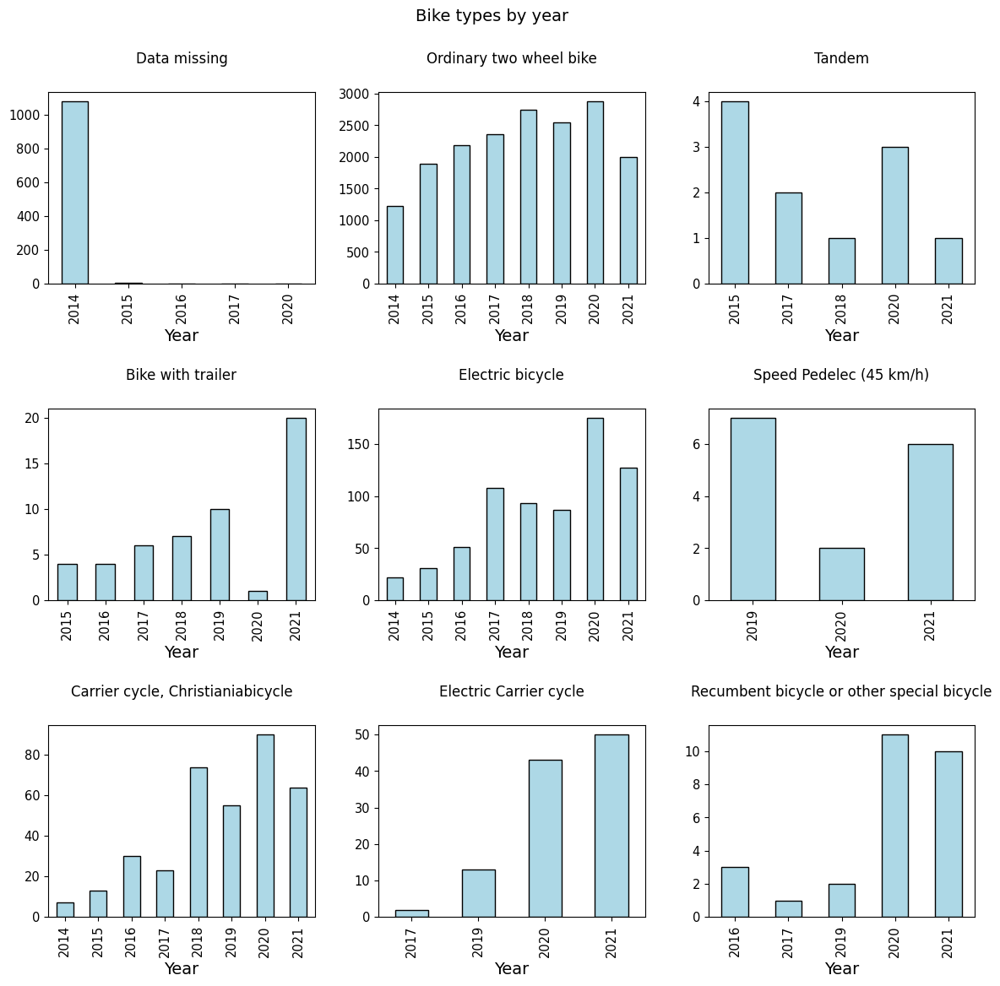

In [48]:
bictype_list = []
for key in bictype_dict.keys():
    bictype_list.append(key)

fig, axs = plt.subplots(3,3, figsize = (12, 12))
bictype_counts = focustripsAfter2013.groupby(["BicType", "Year"])["TurId"].count()

for i, ax in enumerate(axs.flat):
    ax.set_title(bictype_dict[bictype_list[i]], fontsize = 12)
    bictype_counts[bictype_list[i]].plot(kind = 'bar', ax = ax, facecolor = "lightblue", edgecolor = "black")
    
fig.suptitle("Bike types by year", fontsize = 14)
plt.tight_layout(pad=2.0)

### Regression Modeling

Due to the rather large amount of data collected, we attempted to make are supervised machine leraning model to predict the time that bike trip would take. For that reason both linear regression and decision tree regresion were developed. 

But first, in order to get some basic knowledge and intuition about the data we performed the Pearson correlation [11] among the parameters and presented it in a form of a heatmap. 

In [49]:
# Merge together tur and session
result = tur_columns.merge(session_columns, how='inner', on='SessionId')
result = result.fillna(0)
result = result.loc[result['PrimMode'] == 2] #Choose bikers

#Follow the X and y convention
X = result.drop(['SumMin','TurId','SessionId','Date','DepartHH','DepartMM','DiaryDate','HomeAdrNearestStation'],1)
y = result['SumMin']

C:\Users\majah\AppData\Local\Temp/ipykernel_31584/2931103700.py:7: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  X = result.drop(['SumMin','TurId','SessionId','Date','DepartHH','DepartMM','DiaryDate','HomeAdrNearestStation'],1)


In [50]:
#Hold Out testing split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

<AxesSubplot:>

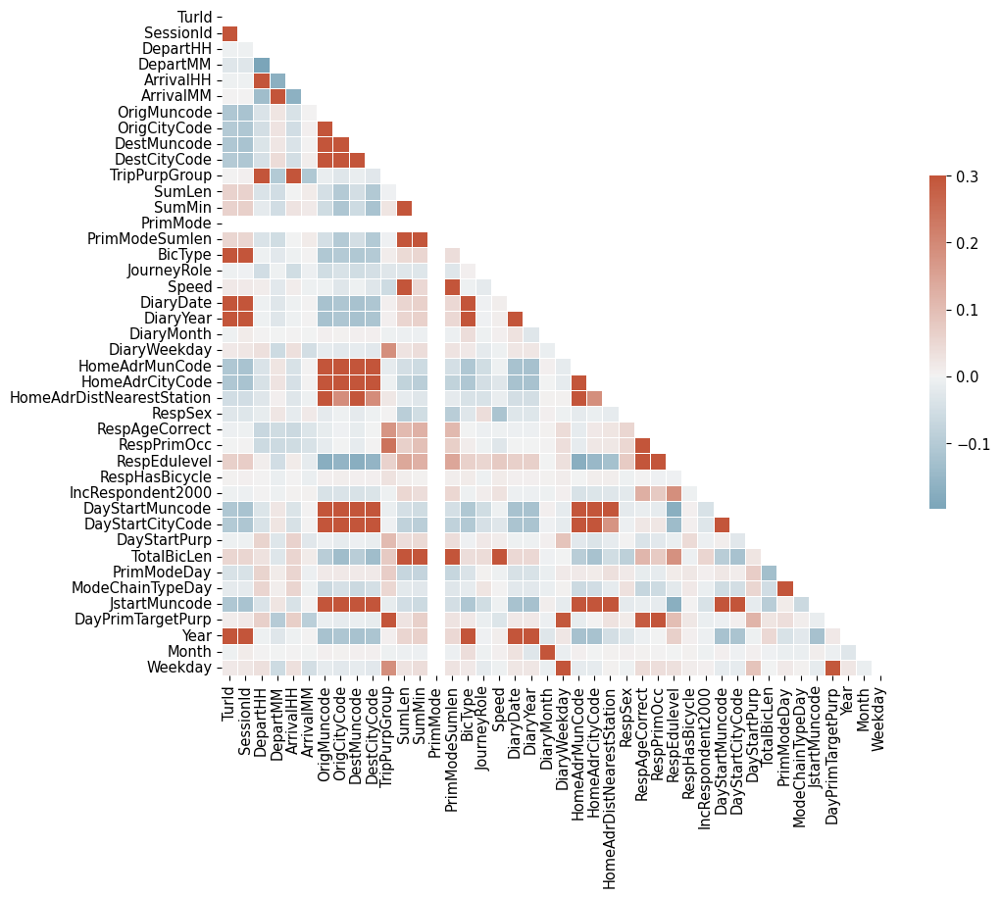

In [51]:
#Correlation Heatmap
corr = result.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [52]:
#Linear Regression
reg = LinearRegression().fit(X_train, y_train)
y_pred = reg.predict(X_test)

In [53]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 3.0023639702129237
Mean Squared Error: 39.20683114260167
Root Mean Squared Error: 6.261535845349899


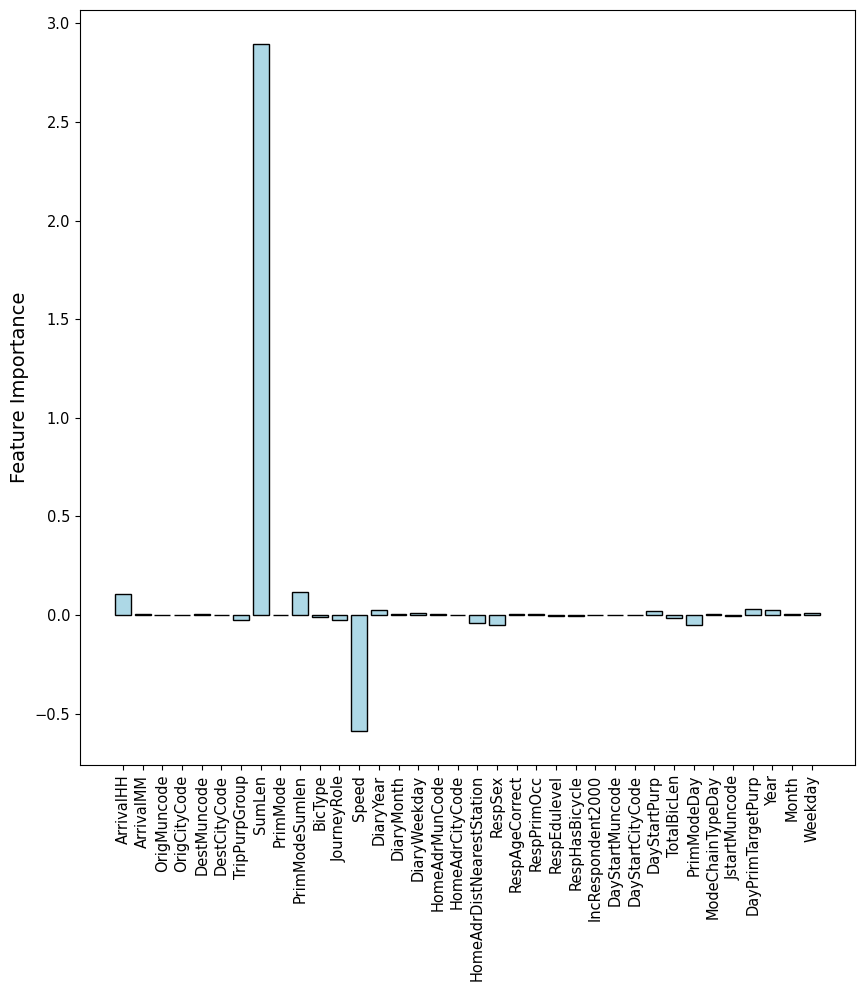

In [54]:
# Illustrate regression coefficients
plt.figure(figsize=(10, 10))
plt.bar(X.columns,reg.coef_,color="black", facecolor = "lightblue", edgecolor = "black")
plt.xticks(rotation=90)
plt.ylabel("Feature Importance")
plt.show()

Text(0, 0.5, 'Frequency')

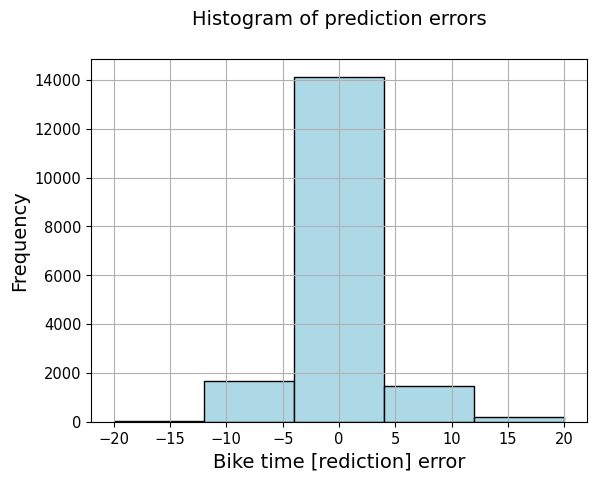

In [55]:
# Calcualte the error
diff = y_test - y_pred
diff.hist(bins = 5,range=[-20, 20],  facecolor = "lightblue", edgecolor = "black")
# and Illustrate it
plt.title('Histogram of prediction errors')
plt.xlabel('Bike time [rediction] error')
plt.ylabel('Frequency')

As our idea was to predict the time, we focused on the 'SumMin' category. It can be observed that the value is correlated with PrimModeSumlen - the primary mode of transport summed distance, total bicycle length, and summed distance. Those values seem to be quite intuitive as recorded trips with higher lengths will be probably longer and the trips with higher total distances performed on bike probably would have also recorded longer trips. First, we performed a linear regression on the gathered data. The resulted Mean Absolute Error was 3.87. To illustrate the importance of the features the weights of coefficients resulting from the regression are presented below. It can be observed that the most influence on the time of the bike trip has the 'SumLength' feature what makes perfect sense as when the distance is longer the time will be longer. The second and third higher weights are 'PrimamryModeSumLenght' and 'RespHasBicycle' respectively. This also checks out as owners of bikes probably choose to have better equipment and if the total sum of trips is higher that means that the endurance of the biker is higher which will result in lower trip time. Last it can be observed that men are a bit faster than women when it comes to biking.

Surprisingly the time of the year does not influence the trip time. However, the cause of it can be connected with the fact that people are more likely to cycle [12] when it is warmer. Therefore people cycling in winter can be more experienced ones.

In [56]:
#Decision Tree Regression
rng = np.random.RandomState(1)
regr_2 = DecisionTreeRegressor(max_depth=9,min_samples_leaf=5)
regr_2.fit(X_train, y_train)
y_2 = regr_2.predict(X_test)

In [57]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_2))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_2))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_2)))

Mean Absolute Error: 0.3264291814987934
Mean Squared Error: 4.126618903259025
Root Mean Squared Error: 2.0314081084949485


Text(0, 0.5, 'Frequency')

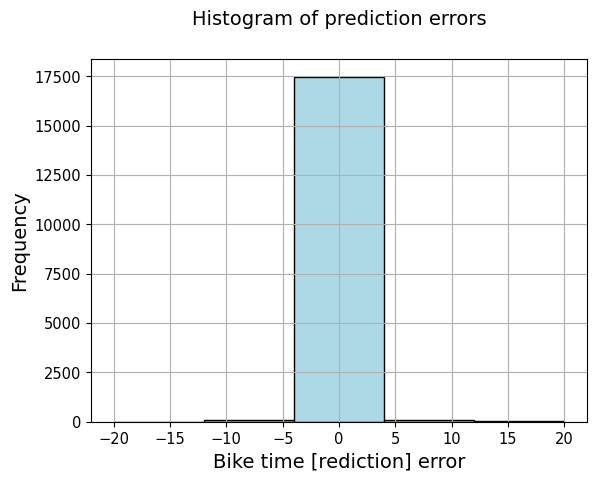

In [58]:
# Calcualte the error
diff = y_test - y_2
diff.hist(bins = 5,range=[-20, 20],  facecolor = "lightblue", edgecolor = "black")
# and Illustrate it
plt.title('Histogram of prediction errors')
plt.xlabel('Bike time [rediction] error')
plt.ylabel('Frequency')

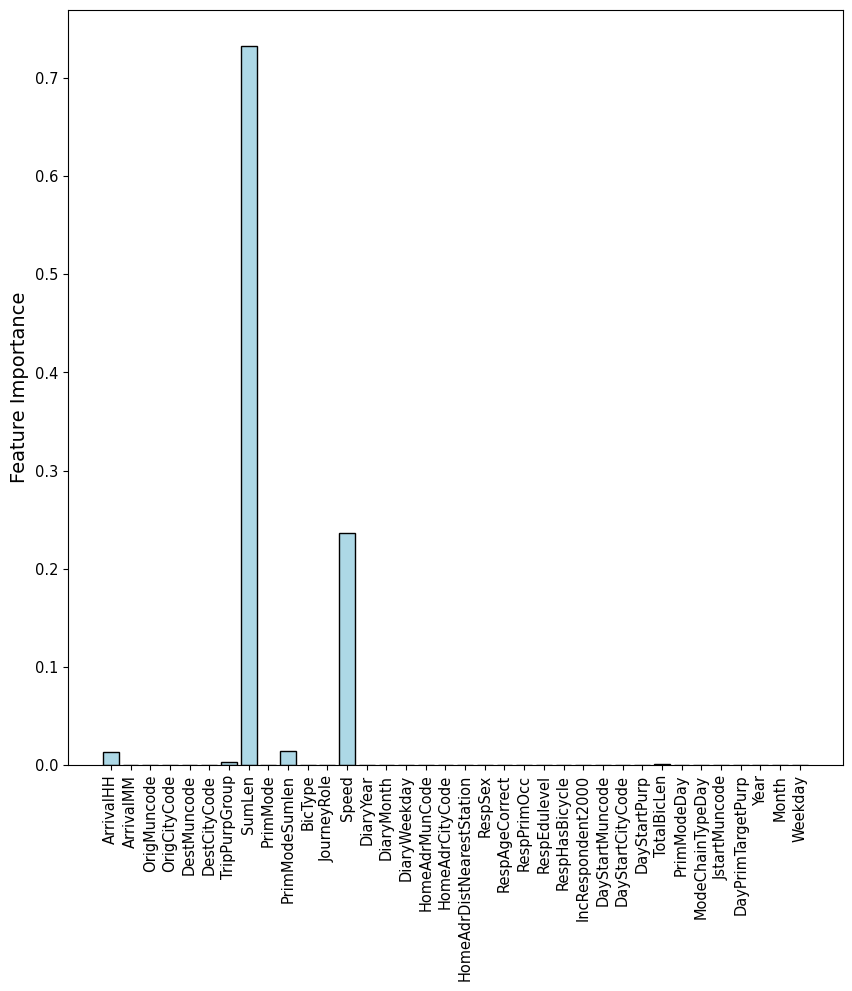

In [59]:
# Illustrate decision tree feature importance
plt.figure(figsize=(10, 10))
plt.bar(X.columns,regr_2.feature_importances_,color="black",facecolor = "lightblue", edgecolor = "black")
plt.xticks(rotation=90)
plt.ylabel("Feature Importance")
plt.show()

To compare the result and feature importance, as said before, we also performed the Decision Tree-based regression. The Mean Absolute Error this time was lower: 3.15. By looking at the feature importance it can be observed that even though again 'SumLen' is the most important one the second and third are different than in Linear Regression. This actually highlights a very important fact, that feature importance may vary across different models and there is no best feature selection method [13].

By presenting the couple of first nodes of the treee we can actually observe that the first seven only takes into account the "SumLen" feature, what again underlines the importance of this element.


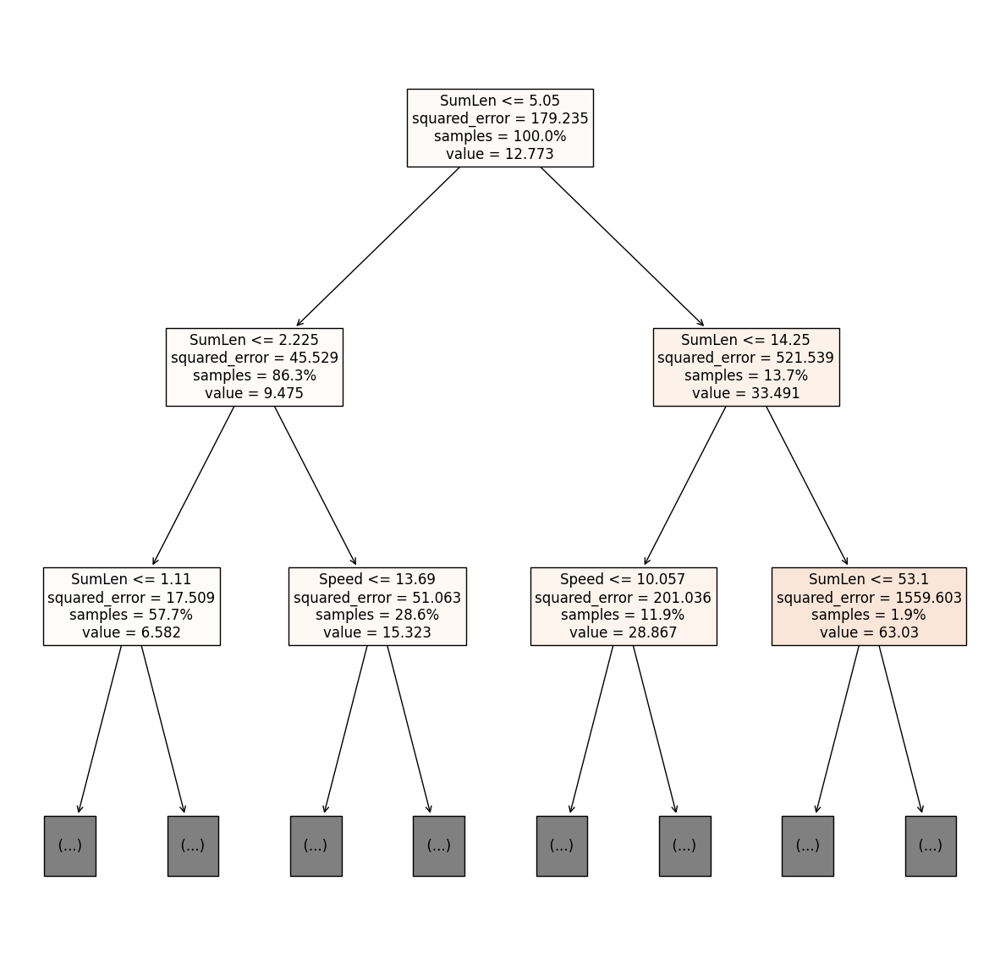

In [60]:
# First tree nodes...
plt.figure(figsize=(15, 15)) # Resize figure
plot_tree(regr_2,feature_names=X.columns, filled=True, proportion=True,fontsize=12,max_depth=2)
plt.show()

## 4) Genre

This section describes the Design Space Dimensions we have used for the project.

**Narrative genre**<br/>
We will make use of several genres of narrative visualization [2]. For example, a multi-view visualization (“partitioned poster”) to have a loose order to images, possibly combined with Flow Chart to suggest a path to the viewer. Time-series data can be displayed using Annotated Graphs with tabs that allow for interactivity by selecting the time range one is interested in seeing. 

**Visual Narrative**<br/>
We have made use of several visual devices to assist and facilitate the narrative. Some of our interactive plots contain tabs or a timeline slider to communicate the overall structure within the larger organization of the visualization. Color and size have been used to highlight specific elements of our plots and direct the reader's attention to important parts. We have made limited use of Transition guidance tools, since most our visualizations don't contain film or moving images.

**Narrative Structure**<br/>
For the ordering of the website content we have aimed for a user directed path without a prescribed ordering of plots and a high degree of interactivity. The interactive components include hovering, selection and navigation buttons that allow the reader to create a customized view of the data. From the messaging tools, we have made use of captions and annotations to provide observations and explanations about the plots. 



## 5) Visualizations
Bokeh plots are very aesthetic and allows to stack panels into tabs, therefore it was our choice to present basic statistic.

Maps are cool so dicided to use them, we were able to find the geojson of Denmark and it felt natural to make the map divided into municipalities and plot some statistics on it.

When it comes to heatmap, it is the best way to show a distirbution of biking across the country.

### Bokeh plots

In [61]:
from bokeh.models import ColumnDataSource, LinearColorMapper, ColorBar, BasicTicker, PrintfTickFormatter, HoverTool, Label, Slope, Legend, FactorRange, Select, CustomJS 
from bokeh.io import push_notebook, show, output_notebook, reset_output, output_file, save
from bokeh.layouts import row, column
from bokeh.plotting import show, figure
from bokeh.models.widgets import Panel, Tabs
from bokeh.palettes import Category20, Reds8
from bokeh.transform import transform
from bokeh.resources import CDN
from bokeh.embed import file_html

output_notebook()

Loading BokehJS ...

In [62]:
focustrips = pd.read_csv('focustrips_proc.csv')

In [63]:
focustrips_yearly = focustrips.groupby(['Year','OrigMuncode'])['OrigMuncode'].count().unstack()
focustrips_yearly = focustrips_yearly.fillna(0)
focustrips_yearly = focustrips_yearly.reset_index()

new_cols = ['Year', 'Copenhagen', 'Frederiksberg', 'Gentofte', 'Gladsaxe', 'Lyngby', 'Roskilde', 'Odense', 'Soenderborg', 
            'Esbjerg', 'Vejle', 'Herning', 'Silkeborg', 'Aarhus', 'Viborg', 'Aalborg']   
focustrips_yearly.columns = new_cols
    
focustrips_yearly

,Year,Copenhagen,Frederiksberg,Gentofte,Gladsaxe,Lyngby,Roskilde,Odense,Soenderborg,Esbjerg,Vejle,Herning,Silkeborg,Aarhus,Viborg,Aalborg
0,2007,986,159,89,59,83,90,395,103,158,67,140,93,430,110,527
1,2008,816,173,78,92,71,116,349,104,167,85,123,93,371,82,349
2,2009,1364,268,138,149,112,122,420,127,206,115,216,180,573,197,329
3,2010,1537,255,180,118,134,191,549,135,264,120,194,131,597,147,314
4,2011,1109,229,136,132,117,114,423,89,217,75,136,131,415,100,254
5,2012,780,145,73,61,77,78,264,43,94,52,71,94,327,60,145
6,2013,796,114,80,62,54,45,162,61,64,50,39,46,270,42,154
7,2014,853,210,90,47,48,47,232,69,94,36,63,62,292,57,134
8,2015,682,123,49,56,47,60,184,47,91,35,46,54,293,51,124
9,2016,809,226,71,101,43,59,191,50,89,60,77,45,301,32,123


In [64]:
source = ColumnDataSource(focustrips_yearly)

muns = new_cols[1:]

p = figure(plot_width = 950, plot_height = 500, title = 'Number of samples by year for each municipality', 
           x_axis_label = 'Year', y_axis_label = 'Sample count') 
names = ['bar1', 'bar2', 'bar3', 'bar4', 'bar5','bar6', 'bar7', 'bar8', 'bar9', 'bar10', 'bar11', 'bar12', 'bar13', 'bar14', 'bar15']

legend_labels = []
bar = {} # to store vbars 
for indx, i in enumerate(muns):
    bar[i] = p.vbar(x='Year', top=i, source=source, line_color = 'black', color = Category20[15][indx], alpha = 0.6, name = names[indx])
    legend_labels.append(i)

legend = Legend(items = [
    (legend_labels[0], [bar[legend_labels[0]]]),
    (legend_labels[1], [bar[legend_labels[1]]]),
    (legend_labels[2], [bar[legend_labels[2]]]),
    (legend_labels[3], [bar[legend_labels[3]]]),
    (legend_labels[4], [bar[legend_labels[4]]]),
    (legend_labels[5], [bar[legend_labels[5]]]),
    (legend_labels[6], [bar[legend_labels[6]]]),
    (legend_labels[7], [bar[legend_labels[7]]]),
    (legend_labels[8], [bar[legend_labels[8]]]),
    (legend_labels[9], [bar[legend_labels[9]]]),
    (legend_labels[10], [bar[legend_labels[10]]]),
    (legend_labels[11], [bar[legend_labels[11]]]),
    (legend_labels[12], [bar[legend_labels[12]]]),
    (legend_labels[13], [bar[legend_labels[13]]]),
    (legend_labels[14], [bar[legend_labels[14]]])
], location = 'center')

hover1 = HoverTool(names = ['bar1'])
hover1.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Copenhagen")]
hover2 = HoverTool(names = ['bar2'])
hover2.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Frederiksberg")]
hover3 = HoverTool(names = ['bar3'])
hover3.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Gentofte")]
hover4 = HoverTool(names = ['bar4'])
hover4.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Gladsaxe")]
hover5 = HoverTool(names = ['bar5'])
hover5.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Lyngby")]
hover6 = HoverTool(names = ['bar6'])
hover6.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Roskilde")]
hover7 = HoverTool(names = ['bar7'])
hover7.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Odense")]
hover8 = HoverTool(names = ['bar8'])
hover8.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Soenderborg")]
hover9 = HoverTool(names = ['bar9'])
hover9.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Esbjerg")]
hover10 = HoverTool(names = ['bar10'])
hover10.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Vejle")]
hover11 = HoverTool(names = ['bar11'])
hover11.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Herning")]
hover12 = HoverTool(names = ['bar12'])
hover12.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Silkeborg")]
hover13 = HoverTool(names = ['bar13'])
hover13.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Aarhus")]
hover14 = HoverTool(names = ['bar14'])
hover14.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Viborg")]
hover15 = HoverTool(names = ['bar15'])
hover15.tooltips = [('Year', "@Year"), ('Number of bike trips in municipality', "@Aalborg")]
p.add_tools(hover1, hover2, hover3, hover4, hover5, hover6, hover7, hover8, hover9, hover10, hover11, hover12, hover13, hover14, hover15)

# Layout settings
p.axis.axis_label_text_font_style = 'normal'
p.xaxis.axis_label_text_font_size = "14pt"
p.yaxis.axis_label_text_font_size = "14pt"
p.title.text_font_size = '12pt'
p.yaxis.major_label_text_font_size = "12pt"
p.xaxis.major_label_text_font_size = "12pt"

p.add_layout(legend, 'right')
p.legend.click_policy="hide" #assigns the click policy
show(p) #displays plot

# output_file('html_files/intro_plot.html')
# save(p)

Every cyclist in the transport survey bikes 2.56 trips per day on average. The bike is mostly used for travelling short distances around 2-4 km. Hence, people use the bike to go around in their close surroundings, but what is their purpose at the destination? The purpose of the bike trip is defined as the purpose at the destination that is opposite home. Hence, if a trip consists of going home from work, the purpose will still be Workplace. The Education category is going to/from school or another educational institution. Errand includes several activities, such as collecting/bringing others or going shopping. The Leisure category covers youth clubs, day care, church, visiting family or going to do sports. Lastly, Business describes purposes such as conferences, customer visits and other commercial transport.

Here are our conclusions:

**Age 5-19:** The youngest age group bikes to school in the morning between 7-8am and home again early in the afternoon at around 1-3pm. In the afternoon and evening hours, Leisure is their primary bike trip purpose, hence they bike to some sort of sparetime activity. People in this age group run very few errands and the Business category is also negligible.<br/>
**Age 20-39:** From 20-39 years of age, the Educational purpose is almost entirely replaced by Workplace. Hence, people at this age have finished school and now bike to and from work instead. The day is a couple of hours longer for the 20-39 year olds than for the youngest age group and they go home from work at 3-5pm. Errand make out a large part of the bike trip purposes in the afternoon, but there is still time to leisure activities as well.<br/>
**Age 40-59:** The bike habits for this age group are similar to those of people who are 20 years younger. They go to and from work at roughly the same times and spend the afternoon running errands an doing freetime activities. The Business purposes are uniformly distributed throughout the day, however, there is a decent number of business activities happening at midnight. Wonder what these could be...<br/>
**Age 60-90:** At this age, only a few people still go to work so they have the time to run errands and to leisurely activities during the day between 9am and 4pm. Interestingly, the Errand category make out a majority of the bike trips at noon, which could be due to the fact that retirees like to get their shopping done between 10-12am when the stores aren't so crowded.

In [65]:
focustrips_purpose = focustrips.copy()

In [66]:
# Age 5-19
focustrips_purpose20 = focustrips[focustrips['Age'] < 20].copy()
focustrips_purpose20['DepartHH'] = focustrips_purpose20['DepartHH'].replace([24,25,26],[0,1,2])
focustrips_purpose20 = focustrips_purpose20.groupby(['DepartHH','TripPurpGroup'])['TripPurpGroup'].count().unstack()
focustrips_purpose20 = focustrips_purpose20.fillna(0)
focustrips_purpose20 = focustrips_purpose20.reset_index()

# Age 20-39
focustrips_purpose40 = focustrips[(20 < focustrips['Age']) & (focustrips['Age'] < 40)].copy()
focustrips_purpose40['DepartHH'] = focustrips_purpose40['DepartHH'].replace([24,25,26],[0,1,2])
focustrips_purpose40 = focustrips_purpose40.groupby(['DepartHH','TripPurpGroup'])['TripPurpGroup'].count().unstack()
focustrips_purpose40 = focustrips_purpose40.fillna(0)
focustrips_purpose40 = focustrips_purpose40.reset_index()

# Age 40-59
focustrips_purpose60 = focustrips[(40 < focustrips['Age']) & (focustrips['Age'] < 60)].copy()
focustrips_purpose60['DepartHH'] = focustrips_purpose60['DepartHH'].replace([24,25,26],[0,1,2])
focustrips_purpose60 = focustrips_purpose60.groupby(['DepartHH','TripPurpGroup'])['TripPurpGroup'].count().unstack()
focustrips_purpose60 = focustrips_purpose60.fillna(0)
focustrips_purpose60 = focustrips_purpose60.reset_index()

# Age 60-90
focustrips_purpose90 = focustrips[60 < focustrips['Age']].copy()
focustrips_purpose90['DepartHH'] = focustrips_purpose90['DepartHH'].replace([24,25,26],[0,1,2])
focustrips_purpose90 = focustrips_purpose90.groupby(['DepartHH','TripPurpGroup'])['TripPurpGroup'].count().unstack()
focustrips_purpose90 = focustrips_purpose90.fillna(0)
focustrips_purpose90 = focustrips_purpose90.reset_index()

prim_purp_dict = {11: 'Workplace', 12: 'Educational', 30: 'Errand', 40: 'Leisure', 50: 'Business'}
new_cols = {'DepartHH': 'Hour', 11: 'Workplace', 12: 'Educational', 30: 'Errand', 40: 'Leisure', 50: 'Business'}

focustrips_purpose20 = focustrips_purpose20.rename(columns = new_cols)
focustrips_purpose40 = focustrips_purpose40.rename(columns = new_cols)
focustrips_purpose60 = focustrips_purpose60.rename(columns = new_cols)
focustrips_purpose90 = focustrips_purpose90.rename(columns = new_cols)

In [67]:
focustrips_purpose20

TripPurpGroup,Hour,Workplace,Educational,Errand,Leisure,Business
0,0,3.0000,0.0000,1.0000,19.0000,11.0000
1,1,2.0000,1.0000,2.0000,19.0000,0.0000
2,2,2.0000,2.0000,1.0000,20.0000,0.0000
3,3,1.0000,0.0000,0.0000,5.0000,0.0000
4,4,1.0000,0.0000,0.0000,2.0000,0.0000
5,5,5.0000,0.0000,1.0000,2.0000,0.0000
6,6,19.0000,14.0000,0.0000,8.0000,1.0000
7,7,38.0000,1779.0000,12.0000,44.0000,1.0000
8,8,21.0000,347.0000,15.0000,39.0000,0.0000
9,9,23.0000,87.0000,13.0000,52.0000,1.0000


In [68]:
source20 = ColumnDataSource(focustrips_purpose20)
source40 = ColumnDataSource(focustrips_purpose40)
source60 = ColumnDataSource(focustrips_purpose60)
source90 = ColumnDataSource(focustrips_purpose90)
purps = list(prim_purp_dict.values())
names = ['bar1', 'bar2', 'bar3', 'bar4', 'bar5']

# create figure
p20 = figure(plot_width = 900, plot_height = 500, title = 'Bike trip purpose by age and time of day', x_axis_label = 'Hour',
             y_axis_label = 'Sample count') 

# Create bars for plots in every tab
bar = {}
for indx, i in enumerate(purps):
    bar[i] = p20.vbar(x='Hour',  top=i, source=source20, legend_label=i, line_color = 'black', color = Category20[5][indx],
                      alpha = 0.8, name = names[indx])
p20.legend.click_policy="hide"

p40 = figure(plot_width = 900, plot_height = 500, title = 'Bike trip purpose by age and time of day', x_axis_label = 'Hour',
             y_axis_label = 'Sample count') 
bar = {}
for indx, i in enumerate(purps):
    bar[i] = p40.vbar(x='Hour',  top=i, source=source40, legend_label=i, line_color = 'black', color = Category20[5][indx],
                      alpha = 0.8, name = names[indx])
p40.legend.click_policy="hide"

p60 = figure(plot_width = 900, plot_height = 500, title = 'Bike trip purpose by age and time of day', x_axis_label = 'Hour',
             y_axis_label = 'Sample count') 
bar = {}
for indx, i in enumerate(purps):
    bar[i] = p60.vbar(x='Hour',  top=i, source=source60, legend_label=i, line_color = 'black', color = Category20[5][indx],
                      alpha = 0.8, name = names[indx])
p60.legend.click_policy="hide"

p90 = figure(plot_width = 900, plot_height = 500, title = 'Bike trip purpose by age and time of day', x_axis_label = 'Hour',
             y_axis_label = 'Sample count') 
bar = {}
for indx, i in enumerate(purps):
    bar[i] = p90.vbar(x='Hour',  top=i, source=source90, legend_label=i, line_color = 'black', color = Category20[5][indx],
                      alpha = 0.8, name = names[indx])
p90.legend.click_policy="hide"

# Add hover tool
hover1 = HoverTool(names = ['bar1'])
hover1.tooltips = [('Time', "@Hour o'clock"), ('Workplace', "@Workplace")]
hover2 = HoverTool(names = ['bar2'])
hover2.tooltips = [('Time', "@Hour o'clock"), ('Education', "@Educational")]
hover3 = HoverTool(names = ['bar3'])
hover3.tooltips = [('Time', "@Hour o'clock"), ('Errand', "@Errand")]
hover4 = HoverTool(names = ['bar4'])
hover4.tooltips = [('Time', "@Hour o'clock"), ('Leisure', "@Leisure")]
hover5 = HoverTool(names = ['bar5'])
hover5.tooltips = [('Time', "@Hour o'clock"), ('Business', "@Business")]
p20.add_tools(hover1, hover2, hover3, hover4, hover5)
p40.add_tools(hover1, hover2, hover3, hover4, hover5)
p60.add_tools(hover1, hover2, hover3, hover4, hover5)
p90.add_tools(hover1, hover2, hover3, hover4, hover5)

# Layout settings
p20.axis.axis_label_text_font_style = 'normal'
p20.xaxis.axis_label_text_font_size = "14pt"
p20.yaxis.axis_label_text_font_size = "14pt"
p20.title.text_font_size = '12pt'
p20.yaxis.major_label_text_font_size = "12pt"
p20.xaxis.major_label_text_font_size = "12pt"
p40.axis.axis_label_text_font_style = 'normal'
p40.xaxis.axis_label_text_font_size = "14pt"
p40.yaxis.axis_label_text_font_size = "14pt"
p40.title.text_font_size = '12pt'
p40.yaxis.major_label_text_font_size = "12pt"
p40.xaxis.major_label_text_font_size = "12pt"
p60.axis.axis_label_text_font_style = 'normal'
p60.xaxis.axis_label_text_font_size = "14pt"
p60.yaxis.axis_label_text_font_size = "14pt"
p60.title.text_font_size = '12pt'
p60.yaxis.major_label_text_font_size = "12pt"
p60.xaxis.major_label_text_font_size = "12pt"
p90.axis.axis_label_text_font_style = 'normal'
p90.xaxis.axis_label_text_font_size = "14pt"
p90.yaxis.axis_label_text_font_size = "14pt"
p90.title.text_font_size = '12pt'
p90.yaxis.major_label_text_font_size = "12pt"
p90.xaxis.major_label_text_font_size = "12pt"

tab20 = Panel(child=p20, title="Age 5-19 years")
tab40 = Panel(child=p40, title="Age 20-39 years")
tab60 = Panel(child=p60, title="Age 40-59 years")
tab90 = Panel(child=p90, title="Age 60-90 years")
tabs = Tabs(tabs=[tab20,tab40,tab60,tab90])
    
# output_file('html_files/demographic_plot.html')
# save(tabs)
show(tabs)

The Bokeh plot below gives an overview of the average bike distance per trip versus the average bike length for the same 15 municipalities that are included in ```focustrips```. Each bubble illustrates a municipality and the size of the bubble is proportional to the total number of bike trips in it. The dashed line illustrates the average speed. Municipalities above the line bike faster than the average whereas municipalities below bike slower.

The average bike speed is 14.5 km/h

In [69]:
new_cols = []
for code in focustrips.groupby(['OrigMuncode'])['SumLen'].mean().keys().tolist():
    new_cols.append(city_code_dict[code])

dist = focustrips.groupby(['OrigMuncode'])['SumLen'].mean().values
mins = focustrips.groupby(['OrigMuncode'])['SumMin'].mean().values
count = focustrips.groupby(['OrigMuncode'])['SumMin'].count().values

df_plot = pd.DataFrame([], columns = [])
df_plot['Municipality'] = new_cols
df_plot['Len'] = dist
df_plot['Min'] = mins
df_plot['Speed'] = dist/mins*60
df_plot['Count'] = count
df_plot['Count_scaled'] = count*0.01
df_plot

,Municipality,Len,Min,Speed,Count,Count_scaled
0,København,3.4087,14.3498,14.2528,15999,159.9900
1,Frederiksberg,3.0078,13.0514,13.8275,2881,28.8100
2,Gentofte,3.7648,14.7487,15.3158,1321,13.2100
3,Gladsaxe,3.6689,14.6870,14.9885,1313,13.1300
4,Lyngby-Taarbæk,3.9091,14.9441,15.6951,1019,10.1900
5,Roskilde,2.8807,12.0824,14.3055,1517,15.1700
6,Odense,3.2891,13.2534,14.8903,4168,41.6800
7,Sønderborg,2.8990,12.7124,13.6830,1036,10.3600
8,Esbjerg,2.8362,11.7766,14.4499,1867,18.6700
9,Vejle,3.1851,13.4321,14.2274,928,9.2800


In [70]:
# linear equation parameters
gradient = 0.24178184192312108
y_intercept = 0

source = ColumnDataSource(df_plot)
p = figure(plot_width = 900, plot_height = 600, x_axis_label = 'Average bike duration [Min]',
           y_axis_label = 'Average bike distance [km]')

Reds8 = tuple(reversed(Reds8))

color_mapper = LinearColorMapper(palette = Reds8, low = df_plot['Speed'].min(), high = df_plot['Speed'].max())
color_bar = ColorBar(color_mapper = color_mapper,
                     location = (0, 0),
                     ticker = BasicTicker(),
                     major_label_text_font_size='14pt')

color_bar_plot = figure(title="Bike speed", title_location="right", 
                        height=600, width=150, 
                        toolbar_location=None, min_border=0, 
                        outline_line_color=None)

color_bar_plot.add_layout(color_bar, 'right')
color_bar_plot.title.align="center"
color_bar_plot.title.text_font_size = '16pt'

p.scatter(x = 'Min', y = 'Len', size = 'Count_scaled', fill_color = transform('Speed', color_mapper),
          line_color = 'black', source = source)

slope = Slope(gradient=gradient, y_intercept=y_intercept, line_color='grey', line_dash='dashed', line_width=3.5)

p.add_layout(slope)

mytext1 = Label(x=11, y=3.9, text='Above average speed 🚀', text_font_size='20pt', text_font_style='italic')
mytext = Label(x=13, y=2.65, text='🐌 Below average speed', text_font_size='20pt', text_font_style='italic')
p.add_layout(mytext1)
p.add_layout(mytext)

p.xaxis.axis_label_text_font_size = "20pt"
p.yaxis.axis_label_text_font_size = "20pt"
p.axis.axis_label_text_font_style = 'normal'

p.add_tools(HoverTool(tooltips = [('Municipality', '@Municipality'), ('Total number of bike trips', '@Count'), 
                                  ('Average bike distance', '@Len{0.0}'), ('Average bike duration', '@Min{0.0}'), 
                                  ('Average speed', '@Speed{0.0}')]))

layout = row(p, color_bar_plot)

show(layout)

# output_file('html_files/average_speed.html')
# save(p)

In [71]:
focustripsAfter2013 = focustrips[focustrips['Year'] > 2013]
bictype_counts = focustripsAfter2013.groupby(["Year", "BicType"])["BicType"].count().unstack()
bictype_counts = bictype_counts.fillna(0)
bictype_counts = bictype_counts.reset_index()
bictype_counts = bictype_counts.rename(columns = bictype_dict)
bictype_counts = bictype_counts.drop(columns = 'Data missing')
bictype_counts

BicType,Year,Ordinary two wheel bike,Tandem,Bike with trailer,Electric bicycle,Speed Pedelec (45 km/h),"Carrier cycle, Christianiabicycle",Electric Carrier cycle,Recumbent bicycle or other special bicycle
0,2014,1226.0000,0.0000,0.0000,22.0000,0.0000,7.0000,0.0000,0.0000
1,2015,1887.0000,4.0000,4.0000,31.0000,0.0000,13.0000,0.0000,0.0000
2,2016,2187.0000,0.0000,4.0000,51.0000,0.0000,30.0000,0.0000,3.0000
3,2017,2355.0000,2.0000,6.0000,108.0000,0.0000,23.0000,2.0000,1.0000
4,2018,2742.0000,1.0000,7.0000,93.0000,0.0000,74.0000,0.0000,0.0000
5,2019,2551.0000,0.0000,10.0000,87.0000,7.0000,55.0000,13.0000,2.0000
6,2020,2881.0000,3.0000,1.0000,175.0000,2.0000,90.0000,43.0000,11.0000
7,2021,1996.0000,1.0000,20.0000,127.0000,6.0000,64.0000,50.0000,10.0000


Looking at all the bike trips in the dataset, we were interested in exploring the development in the use of bicycles to see if there has been an increase in this clean mode of transport. Moreover, we wanted to investigate whether there has been an increase in the use of electric bikes, since these are a great alternative for commuting by car if your don’t want to break a sweat on your way to work. Hence, E-bikes can help fight global climate change [3]. In fact, research studies suggests that using an electric bike could have a positive impact on the environment. A recent study by Ian Phillips et al. concluded that e-bikes have the capability to reduce car CO2 emissions by 24.4 million tonnes a year in England [4].

In the interactive plot below shows the number of bike trips by year showing the eight different bicycles types that are represented in the dataset. Notice that the question of bicycle type has only been included in the Danish National Travel Survey since 2014, hence years on the x-axis ranges from 2014-2021. It is obvious that the ordinary two wheel bike is by far the most dominant bicycle type. Zoom in on the remaining curves to see that E-bikes and Christiniabicycles are the second- and thirdmost popular types, respectively. The other bike types have a very low number of counts in the range of 0-20 observations per year. This plot allows you to toggle on the curves you want to see by selecting or deselecting the bike types in the legend.

In [72]:
bictype_dict

{0: 'Data missing',
 20: 'Ordinary two wheel bike',
 21: 'Tandem',
 22: 'Bike with trailer',
 23: 'Electric bicycle',
 24: 'Speed Pedelec (45 km/h)',
 30: 'Carrier cycle, Christianiabicycle',
 33: 'Electric Carrier cycle',
 40: 'Recumbent bicycle or other special bicycle',
 99: 'Different bikes on the individual parts of the trip'}

In [73]:
def smoothify(x, y): 
    # Function to smoothen curves
    spl = splrep(x, y)
    x2 = np.linspace(min(x), max(x), 100)
    y2 = splev(x2, spl)
    return x2, y2

In [74]:
bictype_counts

BicType,Year,Ordinary two wheel bike,Tandem,Bike with trailer,Electric bicycle,Speed Pedelec (45 km/h),"Carrier cycle, Christianiabicycle",Electric Carrier cycle,Recumbent bicycle or other special bicycle
0,2014,1226.0000,0.0000,0.0000,22.0000,0.0000,7.0000,0.0000,0.0000
1,2015,1887.0000,4.0000,4.0000,31.0000,0.0000,13.0000,0.0000,0.0000
2,2016,2187.0000,0.0000,4.0000,51.0000,0.0000,30.0000,0.0000,3.0000
3,2017,2355.0000,2.0000,6.0000,108.0000,0.0000,23.0000,2.0000,1.0000
4,2018,2742.0000,1.0000,7.0000,93.0000,0.0000,74.0000,0.0000,0.0000
5,2019,2551.0000,0.0000,10.0000,87.0000,7.0000,55.0000,13.0000,2.0000
6,2020,2881.0000,3.0000,1.0000,175.0000,2.0000,90.0000,43.0000,11.0000
7,2021,1996.0000,1.0000,20.0000,127.0000,6.0000,64.0000,50.0000,10.0000


In [75]:
bictype_pct = bictype_counts.copy()

for i in range(len(bictype_counts) - 1):
    j = i + 1
    i = 0
    bictype_pct.iloc[j,1:] = (bictype_counts.iloc[j,1:] - bictype_counts.iloc[i,1:])*100 / bictype_counts.iloc[i,1:]

bictype_pct.iloc[0,1:] = np.zeros(8)
bictype_pct = bictype_pct.fillna(0)
bictype_pct.replace(np.inf,100,inplace=True)
bictype_pct = bictype_pct.reset_index(drop = True)
bictype_pct

BicType,Year,Ordinary two wheel bike,Tandem,Bike with trailer,Electric bicycle,Speed Pedelec (45 km/h),"Carrier cycle, Christianiabicycle",Electric Carrier cycle,Recumbent bicycle or other special bicycle
0,2014,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
1,2015,53.9152,100.0000,100.0000,40.9091,0.0000,85.7143,0.0000,0.0000
2,2016,78.3850,0.0000,100.0000,131.8182,0.0000,328.5714,0.0000,100.0000
3,2017,92.0881,100.0000,100.0000,390.9091,0.0000,228.5714,100.0000,100.0000
4,2018,123.6542,100.0000,100.0000,322.7273,0.0000,957.1429,0.0000,0.0000
5,2019,108.0750,0.0000,100.0000,295.4545,100.0000,685.7143,100.0000,100.0000
6,2020,134.9918,100.0000,100.0000,695.4545,100.0000,1185.7143,100.0000,100.0000
7,2021,62.8059,100.0000,100.0000,477.2727,100.0000,814.2857,100.0000,100.0000


In [76]:
bic_types = list(bictype_dict.values())[1:9]

# first plots
source1 = ColumnDataSource(bictype_counts)

p1 = figure(plot_width=1000, plot_height=400, title = 'Number of bike trips by year and bicycle type', x_axis_label = 'Year',
           y_axis_label = 'Count', toolbar_location="below")

# list that contains legend labels
legend1 = []

# add both a line and circles on the same plot
line1 = {}
circle1 = {}
for indx, i in enumerate(bic_types):
    x2, y2 = smoothify(bictype_counts.iloc[:,0],bictype_counts.loc[:,i])
    line1[i] = p1.line(x = x2, y = y2, line_width=2, color = Category20[8][indx])
    circle1[i] = p1.circle(x = 'Year', y = i, source = source1, fill_color="white", size=8)
    legend1.append(i)   
    
# create legend outside plot
legend1 = Legend(items=[
    (legend1[0], [line1[legend1[0]],circle1[legend1[0]]]),
    (legend1[1], [line1[legend1[1]], circle1[legend1[1]]]),
    (legend1[2], [line1[legend1[2]], circle1[legend1[2]]]),
    (legend1[3], [line1[legend1[3]], circle1[legend1[3]]]),
    (legend1[4], [line1[legend1[4]], circle1[legend1[4]]]),
    (legend1[5], [line1[legend1[5]], circle1[legend1[5]]]),
    (legend1[6], [line1[legend1[6]], circle1[legend1[6]]]),
    (legend1[7], [line1[legend1[7]], circle1[legend1[7]]])
], location='center')

p1.axis.axis_label_text_font_style = 'normal'
p1.xaxis.axis_label_text_font_size = "14pt"
p1.yaxis.axis_label_text_font_size = "14pt"
p1.title.text_font_size = '12pt'
p1.yaxis.major_label_text_font_size = "12pt"
p1.xaxis.major_label_text_font_size = "12pt"

p1.add_layout(legend1, 'right')
p1.legend.label_text_font_size = "12pt"

p1.legend.click_policy="hide"

# second plot
source2 = ColumnDataSource(bictype_pct)

p2 = figure(plot_width=1000, plot_height=400, title = 'Percentage increase in bicycle types by year (baseline year = 2014)',
            x_axis_label = 'Year', y_axis_label = 'Percent (%)', toolbar_location="below")

legend2 = []

line2 = {}
circle2 = {}
for indx, i in enumerate(bic_types):
    x2, y2 = smoothify(bictype_pct.iloc[:,0],bictype_pct.loc[:,i])
    line2[i] = p2.line(x = x2, y = y2, line_width=2, color = Category20[8][indx])
    circle2[i] = p2.circle(x = 'Year', y = i, source = source2, fill_color="white", size=8)
    legend2.append(i)
    
legend2 = Legend(items=[
    (legend2[0], [line2[legend2[0]],circle2[legend2[0]]]),
    (legend2[1], [line2[legend2[1]], circle2[legend2[1]]]),
    (legend2[2], [line2[legend2[2]], circle2[legend2[2]]]),
    (legend2[3], [line2[legend2[3]], circle2[legend2[3]]]),
    (legend2[4], [line2[legend2[4]], circle2[legend2[4]]]),
    (legend2[5], [line2[legend2[5]], circle2[legend2[5]]]),
    (legend2[6], [line2[legend2[6]], circle2[legend2[6]]]),
    (legend2[7], [line2[legend2[7]], circle2[legend2[7]]])
], location='center')

p2.axis.axis_label_text_font_style = 'normal'
p2.xaxis.axis_label_text_font_size = "14pt"
p2.yaxis.axis_label_text_font_size = "14pt"
p2.title.text_font_size = '12pt'
p2.yaxis.major_label_text_font_size = "12pt"
p2.xaxis.major_label_text_font_size = "12pt"

p2.add_layout(legend2, 'right')    
p2.legend.label_text_font_size = "12pt"
p2.legend.click_policy="hide"

show(column(p1, p2))

# output_file('html_files/bike_type_part1.html')
# save(p1)

# output_file('html_files/bike_type_part2.html')
# save(p2)

We're interested to see if there has been an increase in the use of bicycles and especially in the use of E-bikes. From the plot above it certainly looks like there has been a slight increase, but it cannot be stated with certainty from the absolute numbers. In the second plot above, we solve this problem by looking at the percentage increase in the number of bike trips since 2014.

Note that when comparing percentage increase since 2014 we assume that the total number of bike trips per year stays roughly constant. The use of Christianiabicycles has increased significantly (800%) from 2014 -2021! The E-bikes has also become more popular with 5-fold increase compared to the 2014 baseline. Interestingly, the ordinary two wheel bike retains its popularity, but it does not seem to be used more often. The same story goes for the remaining bicycle types.

In [77]:
options = list(focustrips.OrigMuncode.map(city_code_dict).unique())

In [78]:
FocusMunCodes = focustrips.OrigMuncode.unique()
FocusMunCodes

array([851, 740, 101, 561, 751, 157, 461, 159, 540, 791, 173, 147, 657,
       630, 265], dtype=int64)

In [79]:
def get_data(mun_code, time_unit):
    mun_column = []
    vals = len(focustrips[time_unit].unique())
    for j in range(vals):
        mun_column.append(city_code_dict[mun_code])
    mun_column = pd.DataFrame(mun_column, columns = ['Municipality'])
    
    df_mun = focustrips[focustrips["OrigMuncode"] == mun_code].groupby([time_unit])["TurId"].count().reset_index()
    df_mun = pd.concat([df_mun, mun_column], axis = 1)
    
    return df_mun 

This last Bokeh plots gives an alternative view of the temporal analysis that was already included in Section 4: Data analysis. The Bokeh plot has 4 tabs and a selection list which makes the visualization a lot more compact than plotting seperate plots with matplotlib.

In [80]:
# Barplot with number of bike trips in selected municipality.
time_unit = 'Month'

# Creating one data frame with all countries for the source. 
df_mun = pd.DataFrame()
for i in range(len(FocusMunCodes)):
    df_mun = pd.concat([df_mun, get_data(FocusMunCodes[i], time_unit)])

current_source = ColumnDataSource(get_data(FocusMunCodes[0], time_unit))
source = ColumnDataSource(df_mun)

p1 = figure(plot_width = 900, plot_height = 500, title = 'Total count of bicycle trips', x_axis_label = time_unit, 
            y_axis_label = 'Count')

# Creating 'Select' list to choose country to view. 
select1 = Select(title="Selected municipality:", value = 'Aalborg', options = options)

# Using js callback to have action while selecting value on 'Select' button. 
callback = CustomJS(args=dict(source=source, sc=current_source, tu=time_unit), code = """
    for (var i = 0; i < source.data['Municipality'].length; i++)
    {
        if(source.data['Municipality'][i] == this.value)
        {
            for(var j = 0; j < sc.data['Municipality'].length; j++)
            {
                sc.data['TurId'][j] = source.data['TurId'][i + j]
                sc.data['Municipality'][j] = source.data['Municipality'][i + j]
                sc.data[tu][j] = source.data[tu][i + j]  
            }
            break;
        }
    }
    sc.change.emit();
""")

p1.vbar(x = time_unit, top = 'TurId', source = current_source, bottom=0, width=0.75, color="lightblue", 
        line_color = 'black', fill_alpha=0.7)

# Add hover tool
hover1 = HoverTool()
hover1.tooltips = [('Number of 🚲 trips', "@TurId")]
p1.add_tools(hover1)

p1.axis.axis_label_text_font_style = 'normal'
p1.xaxis.axis_label_text_font_size = "14pt"
p1.yaxis.axis_label_text_font_size = "14pt"
p1.title.text_font_size = '12pt'
p1.yaxis.major_label_text_font_size = "12pt"
p1.xaxis.major_label_text_font_size = "12pt"

select1.js_on_change("value", callback)
callback.args['select1'] = select1

tab1 = Panel(child = column(column(select1), p1), title = 'Month')

In [81]:
# Barplot with number of bike trips in selected municipality.
time_unit = 'Weekday'

# Creating one data frame with all countries for the source. 
df_mun = pd.DataFrame()
for i in range(len(FocusMunCodes)):
    df_mun = pd.concat([df_mun, get_data(FocusMunCodes[i], time_unit)])

current_source = ColumnDataSource(get_data(FocusMunCodes[0], time_unit))
source = ColumnDataSource(df_mun)

p2 = figure(plot_width = 900, plot_height = 500, title = 'Total count of bicycle trips', x_axis_label = time_unit, 
            y_axis_label = 'Count')

# Creating 'Select' list to choose country to view. 
select2 = Select(title="Selected municipality:", value = 'Aalborg', options = options)

# Using js callback to have action while selecting value on 'Select' button. 
callback = CustomJS(args=dict(source=source, sc=current_source, tu=time_unit), code = """
    for (var i = 0; i < source.data['Municipality'].length; i++)
    {
        if(source.data['Municipality'][i] == this.value)
        {
            for(var j = 0; j < sc.data['Municipality'].length; j++)
            {
                sc.data['TurId'][j] = source.data['TurId'][i + j]
                sc.data['Municipality'][j] = source.data['Municipality'][i + j]
                sc.data[tu][j] = source.data[tu][i + j]  
            }
            break;
        }
    }
    sc.change.emit();
""")

p2.vbar(x = time_unit, top = 'TurId', source = current_source, bottom=0, width=0.75, color="lightblue", 
        line_color = 'black', fill_alpha=0.7)

# Add hover tool
hover2 = HoverTool()
hover2.tooltips = [('Number of 🚲 trips', "@TurId")]
p2.add_tools(hover2)

p2.axis.axis_label_text_font_style = 'normal'
p2.xaxis.axis_label_text_font_size = "14pt"
p2.yaxis.axis_label_text_font_size = "14pt"
p2.title.text_font_size = '12pt'
p2.yaxis.major_label_text_font_size = "12pt"
p2.xaxis.major_label_text_font_size = "12pt"

select2.js_on_change("value", callback)
callback.args['select2'] = select2

tab2 = Panel(child = column(column(select2), p2), title = 'Weekday')

In [82]:
# Barplot with number of bike trips in selected municipality.
time_unit = 'DepartHH'

# Creating one data frame with all countries for the source. 
df_mun = pd.DataFrame()
for i in range(len(FocusMunCodes)):
    df_mun = pd.concat([df_mun, get_data(FocusMunCodes[i], time_unit)])

current_source = ColumnDataSource(get_data(FocusMunCodes[0], time_unit))
source = ColumnDataSource(df_mun)

p3 = figure(plot_width = 900, plot_height = 500, title = 'Total count of bicycle trips', x_axis_label = 'Hour', 
            y_axis_label = 'Count')

# Creating 'Select' list to choose country to view. 
select3 = Select(title="Selected municipality:", value = 'Aalborg', options = options)

# Using js callback to have action while selecting value on 'Select' button. 
callback = CustomJS(args=dict(source=source, sc=current_source, tu=time_unit), code = """
    for (var i = 0; i < source.data['Municipality'].length; i++)
    {
        if(source.data['Municipality'][i] == this.value)
        {
            for(var j = 0; j < sc.data['Municipality'].length; j++)
            {
                sc.data['TurId'][j] = source.data['TurId'][i + j]
                sc.data['Municipality'][j] = source.data['Municipality'][i + j]
                sc.data[tu][j] = source.data[tu][i + j]  
            }
            break;
        }
    }
    sc.change.emit();
""")

p3.vbar(x = time_unit, top = 'TurId', source = current_source, bottom=0, width=0.75, color="lightblue", 
        line_color = 'black', fill_alpha=0.7)

# Add hover tool
hover3 = HoverTool()
hover3.tooltips = [('Number of 🚲 trips', "@TurId")]
p3.add_tools(hover3)

p3.axis.axis_label_text_font_style = 'normal'
p3.xaxis.axis_label_text_font_size = "14pt"
p3.yaxis.axis_label_text_font_size = "14pt"
p3.title.text_font_size = '12pt'
p3.yaxis.major_label_text_font_size = "12pt"
p3.xaxis.major_label_text_font_size = "12pt"

select3.js_on_change("value", callback)
callback.args['select3'] = select3

tab3 = Panel(child = column(column(select3), p3), title = 'Hour')

In [83]:
# Barplot with number of bike trips in selected municipality.
time_unit = 'HourOfWeek'

# Creating one data frame with all countries for the source. 
df_mun = pd.DataFrame()
for i in range(len(FocusMunCodes)):
    df_mun = pd.concat([df_mun, get_data(FocusMunCodes[i], time_unit)])

current_source = ColumnDataSource(get_data(FocusMunCodes[0], time_unit))
source = ColumnDataSource(df_mun)

p4 = figure(plot_width = 900, plot_height = 500, title = 'Total count of bicycle trips', x_axis_label = 'Hour of week', 
            y_axis_label = 'Count')

# Creating 'Select' list to choose country to view. 
select4 = Select(title="Selected municipality:", value = 'Aalborg', options = options)

# Using js callback to have action while selecting value on 'Select' button. 
callback = CustomJS(args=dict(source=source, sc=current_source, tu=time_unit), code = """
    for (var i = 0; i < source.data['Municipality'].length; i++)
    {
        if(source.data['Municipality'][i] == this.value)
        {
            for(var j = 0; j < sc.data['Municipality'].length; j++)
            {
                sc.data['TurId'][j] = source.data['TurId'][i + j]
                sc.data['Municipality'][j] = source.data['Municipality'][i + j]
                sc.data[tu][j] = source.data[tu][i + j]  
            }
            break;
        }
    }
    sc.change.emit();
""")

p4.vbar(x = time_unit, top = 'TurId', source = current_source, bottom=0, width=0.75, color="lightblue", 
        line_color = 'black', fill_alpha=0.7)

# Add hover tool
hover4 = HoverTool()
hover4.tooltips = [('Number of 🚲 trips', "@TurId")]
p4.add_tools(hover4)

p4.axis.axis_label_text_font_style = 'normal'
p4.xaxis.axis_label_text_font_size = "14pt"
p4.yaxis.axis_label_text_font_size = "14pt"
p4.title.text_font_size = '12pt'
p4.yaxis.major_label_text_font_size = "12pt"
p4.xaxis.major_label_text_font_size = "12pt"

select4.js_on_change("value", callback)
callback.args['select4'] = select4

tab4 = Panel(child = column(column(select4), p4), title = 'Hour of week')

tabs = Tabs(tabs=[tab1, tab2, tab3, tab4])
show(tabs)

# output_file('html_files/temporal_analysis.html')
# save(tabs)

### Geodata

In [84]:
result = tur_columns.merge(session_columns, how='inner', on='SessionId')
result = result.fillna(0)
result = result.loc[result['PrimMode'] == 2]

In [85]:
# Get the geojson
data = gpd.read_file("https://raw.githubusercontent.com/magnuslarsen/geoJSON-Danish-municipalities/master/municipalities/municipalities.geojson")
multidata = data = json.loads(data.dissolve(by='lau_1', aggfunc='first').to_json())

In [86]:
#Count the number of trip orginated in given municipality 
mun_orgi_occ = pd.DataFrame(result['OrigMuncode'].value_counts()).reset_index()
mun_orgi_occ.rename(columns={'index': 'lau_1', 'OrigMuncode': 'value'}, inplace=True)
mun_orgi_occ['lau_1'] = mun_orgi_occ['lau_1'].astype(int).astype('str')

In [87]:
#Group data by municipality
mun_sum_min = result.groupby('OrigMuncode').sum()
mun_sum_min = mun_sum_min.reset_index()
mun_sum_min['OrigMuncode'] = mun_sum_min['OrigMuncode'].astype(int)
mun_sum_min['OrigMuncode'] = mun_sum_min['OrigMuncode'].astype(str)

In [88]:
mun_orgi_occ = mun_orgi_occ.rename(columns={'lau_1': 'OrigMuncode'})

In [89]:
# Comine data together in order to calcluate average
mun_result = mun_sum_min.merge(mun_orgi_occ, how='inner', on='OrigMuncode')

In [90]:
#Calcualte approperiate mean values
mun_result['avg_distance'] = round(mun_result['SumLen']  / mun_result['value'],2)
mun_result['avg_education'] = round(mun_result['RespEdulevel']  / mun_result['value'],2)
mun_result['avg_departHH'] = round(mun_result['DepartHH']  / mun_result['value']) 
mun_result['avg_time'] = mun_result['SumMin']  / mun_result['value'] 
mun_result['avg_inc_reps'] = mun_result['IncRespondent2000']  / mun_result['value'] 
mun_result['DiaryMonth'] = mun_result['DiaryMonth'] / mun_result['value']
mun_result['avg_age'] = mun_result['RespAgeCorrect'] / mun_result['value']

In [91]:
# Method used to fetch munciplaity name basing on its code using API 
def name(x):
    try:
        r = requests.get("https://api.dataforsyningen.dk/kommuner/" + str(int(x)))
        name = r.json()['navn']
    except:
        name = "-"
    return name

In [92]:
#Make dictionary of munciaplities codes and names
mun_codes = mun_result['OrigMuncode'].unique()

name_dicts = {}
for mc in mun_codes:
    name_dicts[mc] = name(mc)

#add new column of names basing on codes
mun_result['mun_name'] = mun_result['OrigMuncode'].map(name_dicts)

In [93]:
#make a map using avg_distance
fig = px.choropleth_mapbox(mun_result, geojson=multidata, locations='OrigMuncode', 
                           featureidkey="id",
                           color='avg_distance',
                           color_continuous_scale="magma",
                           range_color=(2, 4),
                           mapbox_style="carto-positron",
                           zoom=5, center = {"lat": 56.27, "lon": 9.50},
                           opacity=0.5,
                           hover_data={'mun_name':True,'avg_distance':True, 'OrigMuncode':False},
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()
#fig.write_html("distance_map.html")

### Distance Map
In order to illustrate the differences in commuting behaviour across Denmark, we decided to show some values in the form of a map with a breakdown by municipalities. Thanks to muncipaliteis codes available in data and geojson data [5] is was possbile to map servel interesting properties. 
In the first map the average number of kilometers covered by a commune resident. It can be seen that in suburb municipalities of Copenhagen e.g. Brøndby, Glostrup, Ballerup and Lyngby-Taarbæk the average distance is around 4 kilometers and is higher than the total average of average of 3.09. That can be caused by the fact that people decide to commute to the city with their bikes. The same pattern occurs in Syddjurs and Silkeborg where people may commute to Aarhus and in Faaborg-Midtfyn where people may commute to Odense. The clear outlier in that observation is the city of Aalborg and its suburbs where the average biking distance is significantly lower than in other urbanized areas. 

In [94]:
#make a map using avg_education
fig = px.choropleth_mapbox(mun_result, geojson=multidata, locations='OrigMuncode', 
                           featureidkey="id",
                           color='avg_education',
                           color_continuous_scale="magma",
                           range_color=(5, 11),
                           mapbox_style="carto-positron",
                           zoom=5, center = {"lat": 56.27, "lon": 9.50},
                           opacity=0.5,
                           hover_data={'mun_name':True,'avg_education':True, 'OrigMuncode':False},
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()
#fig.write_html("edu_map.html")

### Education Map
We also wanted to check if the education status of average bikers across the country is similar. And as education level is correlated with earnings [6]. We had a suspicion that maybe in cities it may be lower as wealthy homebuyers prefer to live in cities [7] and they can easily choose a car as the primary mode of transport. 

 Knowing that people living in big cities are more likely to be educated [8]. It can be seen that bikers in Copenhagen and Frederiksberg still decide to use bikes to commute. The surprising fact that was discover is that the bikers living on Samso island are having the highest average education level, which acctually contradicts the initial assumption. 

In [95]:
#make a map using avg_departHH
fig = px.choropleth_mapbox(mun_result, geojson=multidata, locations='OrigMuncode', 
                           featureidkey="id",
                           color='avg_departHH',
                           color_continuous_scale="magma",
                           range_color=(12, 13),
                           mapbox_style="carto-positron",
                           zoom=5, center = {"lat": 56.27, "lon": 9.50},
                           opacity=0.5,
                           hover_data={'mun_name':True,'avg_departHH':True, 'OrigMuncode':False},
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()
#fig.write_html("hour_map1.html")

In [96]:
#make a map using DiaryMonth
fig = px.choropleth_mapbox(mun_result, geojson=multidata, locations='OrigMuncode', 
                           featureidkey="id",
                           color='DiaryMonth',
                           color_continuous_scale="magma",
                           range_color=(5, 7),
                           mapbox_style="carto-positron",
                           zoom=5, center = {"lat": 56.27, "lon": 9.50},
                           opacity=0.5,
                           hover_data={'mun_name':True,'DiaryMonth':True, 'OrigMuncode':False},
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()
#fig.write_html("hour_map.html")

### Hour Map
Next the aspect of time was taken into consideration. It has been assumed that in the northen muncipalities, where the temperature is on average is the lowest [9] people will be more likely to cycle at later hours. However, by looking at the map belon it is hard to find any pattern. The only surprising thing again is the island of Samosoe where the average departure hour is lower. As they say "Early to bed and early to rise makes a man healthy, wealthy and wise." might be the case here.

In [97]:
#function used to fetch muncipality cords basing on the mun. code using dataforsyningen API
def get_cords(x):
    try:
        r = requests.get("https://api.dataforsyningen.dk/kommuner/" + str(int(x)))
        lon = r.json()['visueltcenter'][0]
        lat = r.json()['visueltcenter'][1]
    except:
        lon = 0
        lat = 0
    return [lon, lat]

In [98]:
#Make dictonary of mun codes and mun cords
dicts = {}
for mc in mun_codes:
    dicts[int(mc)] = get_cords(int(mc))

In [99]:
# Add cords column basing on muncipality code
result['muncords'] = result['OrigMuncode'].map(dicts)

In [100]:
#split column into two
result[['lon','lat']] = pd.DataFrame(result.muncords.tolist())
temp_result = result.head(10000)

In [101]:
#plot a heatmap basing on obtained data

lat = 56.27
lon = 9.50


map_h1 = folium.Map([lat, lon], zoom_start=7)


# List comprehension to make out list of lists
heat_data = [[row['lat'],row['lon']] for index, row in temp_result.iterrows()]

# Plot it on the map
HeatMap(heat_data).add_to(map_h1)

# Display the map
map_h1
#map_h1.save("heat_map.html")

#### Heat Map
Last but not least, the data has been presented in form of a heat map. For that purpose the dataforsyningen API [10] has been used to pair muncipaliteis with approperiate geographical cords to populate the map. Unsurprisingly people cycle the most around towns. Copenhagen and its surrounding area are the most frequented among cyclists. Then Aarhus, Odense, and Aalborg can be observed as places where the concentration of cyclists is also at a high level. An interesting place on the map is the city of Randers. Even though that area is highly populated it is not popular among cyclers.


## 6) Discussion

The dataset from the Danish National Transport Survey database contains much more data than what we have filtered out in this project. We have chosen to focus on bicycle trips, however, the dataset also contains trips by other modes of transport, for example car, public transport, a combination of those etc. Hence, there is potential for much further analysis. For example, one could investigate the trends in the use of different modes of transport and compare the development in bicycle habits in this perspective. Such analysis would give a more thorough to the answer we tried to answer above: Has there been an increase in the use of bicycles?

One limitiation to the dataset is the geospacial resolution. Locations are given by municipality or city codes, hence we don't have the information of longitude and latitude that is necessary for some geodata representations. On the other hand, the dataset has the advantage that it contains detailed social data which we have exploited in our demagraphic analysis and machine learning predictions. This adds a social dimension to the analysis of Danish bicycle habits which has deepened our understanding of who and why people bike. Gaining insights into how people tend to use different modes of clean transport is an important step towards reducing CO2 emissions in the transport sector, and we truly believe that cycling can help fight climate change.


## 7) References

[1] Danish National Travel Survey, [DOI: 10.11581/dtu:00000034](https://www.cta.man.dtu.dk/transportvaneundersoegelsen/dokumentation). Documentation: [Catalogue of variables]((https://www.tu2022.dk/meta/?lang=EN)).

[2] E. Segel and J. Heer, "Narrative Visualization: Telling Stories with Data," in IEEE Transactions on Visualization and Computer Graphics, vol. 16, no. 6, pp. 1139-1148, Nov.-Dec. 2010, doi: 10.1109/TVCG.2010.179.

[3] The Green Machine: can E-bikes help fight climate change? [Cycleguard.co.uk](https://www.cycleguard.co.uk/how-green-are-ebikes)

[4] Ian Philips, Jillian Anable, Tim Chatterton. E-bikes and their capability to reduce car CO2 emissions. Transport Policy. Volume 116 (2022). Pages 11-23. DOI: https://doi.org/10.1016/j.tranpol.2021.11.019.

[5] Danish municipalities geoJSON, Magnus Larsen https://raw.githubusercontent.com/magnuslarsen/geoJSON-Danish-municipalities/master/municipalities/municipalities.geojson

[6] Blaug, Mark. “The Correlation between Education and Earnings: What Does It Signify?” Higher Education 1, no. 1 (1972): 53–76. http://www.jstor.org/stable/3445959.

[7] Wealthy homebuyers prefer to live in cities, The Guardian, https://www.theguardian.com/money/2015/nov/15/wealthy-homebuyers-prefer-to-live-in-cities

[8] The lure of big cities for the highly educated, Edith S. Baker, https://www.bls.gov/opub/mlr/2016/beyond-bls/pdf/the-lure-of-big-cities-for-the-highly-educated.pdf

[9] Observed Climatology of Mean-Temperature 1991-2020 Denmark, Climate Change Knowledge Portal, https://climateknowledgeportal.worldbank.org/country/denmark/climate-data-historical

[10] Dataforsyningen https://dataforsyningen.dk/

[11] rasbt, Pattern Classification, https://github.com/rasbt/pattern_classification/blob/master/resources/latex_equations.md#correlation---pearson

[12] How does the wether affect the share bicycle usage?, Danish Journal of Transportation Research, https://journals.aau.dk/index.php/djtr/article/download/3560/3106

[13] How to Choose a Feature Selection Method For Machine Learning, Jason Brownlee , https://machinelearningmastery.com/feature-selection-with-real-and-categorical-data/

## 8) Contributions

| **Task**               	| **Responsible**      	| **Contributed** 	|
|------------------------	|:--------------------:	|:---------------:	|
| Data preparation       	|         Andreas / ST197|       All       	|
| Preliminary analysis   	|         Maja / ST149|       All       	|
| Data modelling         	|         Tomasz / ST78|       All       	|
| Geo data visualization 	|         Tomasz / ST78|       All       	|
| Demographic analysis   	|         Maja / ST149|       All       	|
| Website and layout     	|         Andreas / ST197|       All       	|